In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sc
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, MeanShift, estimate_bandwidth, AffinityPropagation
from sklearn.cluster import DBSCAN, Birch, AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.neighbors import NearestNeighbors
from sklearn.pipeline import Pipeline
from kneed import KneeLocator
from sklearn import metrics

In [2]:
data = pd.read_csv("E:/Downloads/country_data.csv")
data

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
0,Afghanistan,90.2,10.0,7.58,44.9,1610,9.44,56.2,5.82,553
1,Albania,16.6,28.0,6.55,48.6,9930,4.49,76.3,1.65,4090
2,Algeria,27.3,38.4,4.17,31.4,12900,16.10,76.5,2.89,4460
3,Angola,119.0,62.3,2.85,42.9,5900,22.40,60.1,6.16,3530
4,Antigua and Barbuda,10.3,45.5,6.03,58.9,19100,1.44,76.8,2.13,12200
...,...,...,...,...,...,...,...,...,...,...
162,Vanuatu,29.2,46.6,5.25,52.7,2950,2.62,63.0,3.50,2970
163,Venezuela,17.1,28.5,4.91,17.6,16500,45.90,75.4,2.47,13500
164,Vietnam,23.3,72.0,6.84,80.2,4490,12.10,73.1,1.95,1310
165,Yemen,56.3,30.0,5.18,34.4,4480,23.60,67.5,4.67,1310


### **Part 1 : Data Analysis**

#### **Overview**

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 167 entries, 0 to 166
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   country     167 non-null    object 
 1   child_mort  167 non-null    float64
 2   exports     167 non-null    float64
 3   health      167 non-null    float64
 4   imports     167 non-null    float64
 5   income      167 non-null    int64  
 6   inflation   167 non-null    float64
 7   life_expec  167 non-null    float64
 8   total_fer   167 non-null    float64
 9   gdpp        167 non-null    int64  
dtypes: float64(7), int64(2), object(1)
memory usage: 13.2+ KB


In [4]:
data.describe()

,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
count,167.000000,167.000000,167.000000,167.000000,167.000000,167.000000,167.000000,167.000000,167.000000
mean,38.270060,41.108976,6.815689,46.890215,17144.688623,7.781832,70.555689,2.947964,12964.155689
std,40.328931,27.412010,2.746837,24.209589,19278.067698,10.570704,8.893172,1.513848,18328.704809
min,2.600000,0.109000,1.810000,0.065900,609.000000,-4.210000,32.100000,1.150000,231.000000
25%,8.250000,23.800000,4.920000,30.200000,3355.000000,1.810000,65.300000,1.795000,1330.000000
50%,19.300000,35.000000,6.320000,43.300000,9960.000000,5.390000,73.100000,2.410000,4660.000000
75%,62.100000,51.350000,8.600000,58.750000,22800.000000,10.750000,76.800000,3.880000,14050.000000
max,208.000000,200.000000,17.900000,174.000000,125000.000000,104.000000,82.800000,7.490000,105000.000000


--- Non of the columns contains missing value.

--- All the features are of numerical type.

--- Visualing is needed to see if there is any outlier.

#### **Data Visualization - 1**

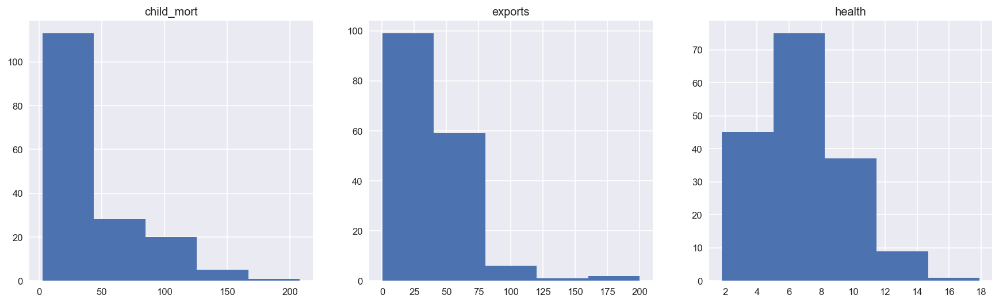

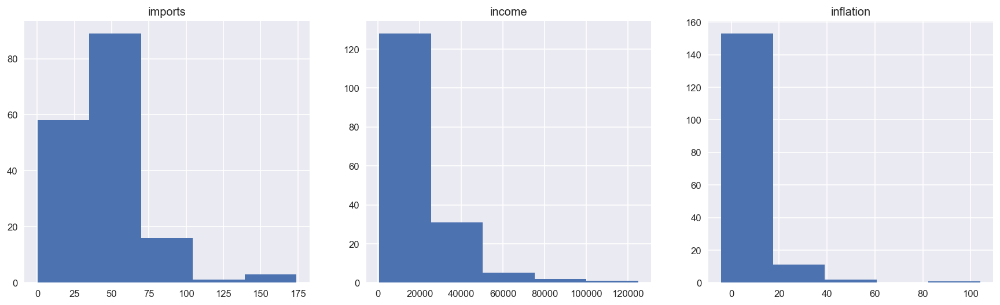

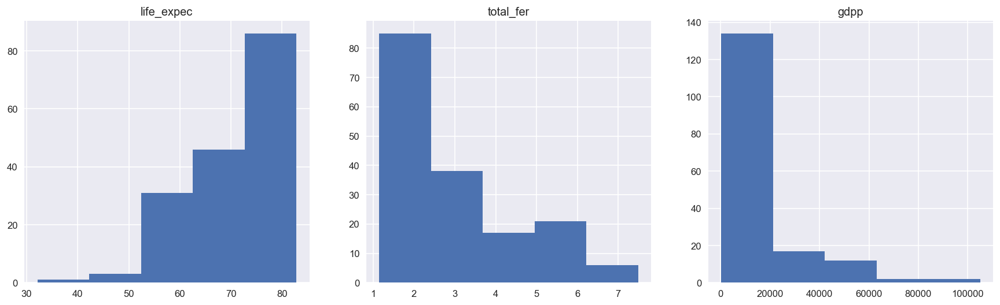

In [5]:
plt.style.use('seaborn')
i = 1
while i < len(data.columns):
    try:
        fig = plt.figure(figsize = (18, 5), dpi = 120)
        plt.subplot(1,3,1)
        plt.hist(data[data.columns[i]], bins = 5)
        plt.title(data.columns[i])
        i += 1
        plt.subplot(1,3,2)
        plt.hist(data[data.columns[i]], bins = 5)
        plt.title(data.columns[i])
        i += 1
        plt.subplot(1,3,3)
        plt.hist(data[data.columns[i]], bins = 5)
        plt.title(data.columns[i])
        i += 1
    except:
        continue
plt.show()

--- It can be seen that only the values of the feature *health* has distributed almost normally.

--- The distribution of the values of the features *child_mort*, *income*, *inflation*, and *gdpp* are heavily skewed.

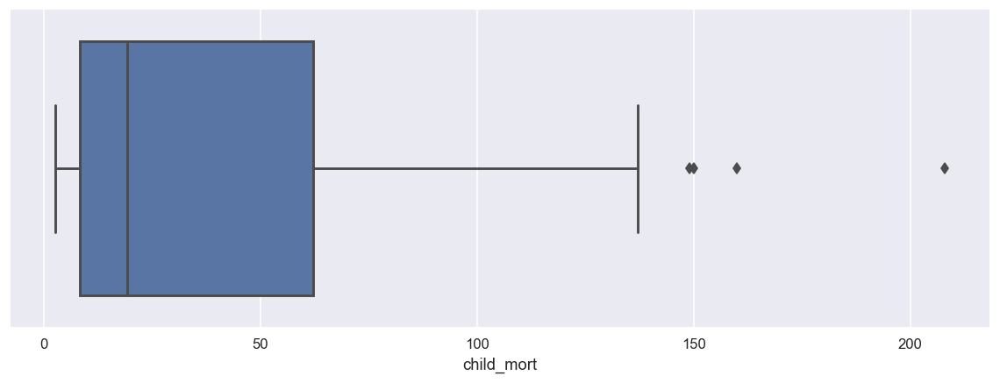

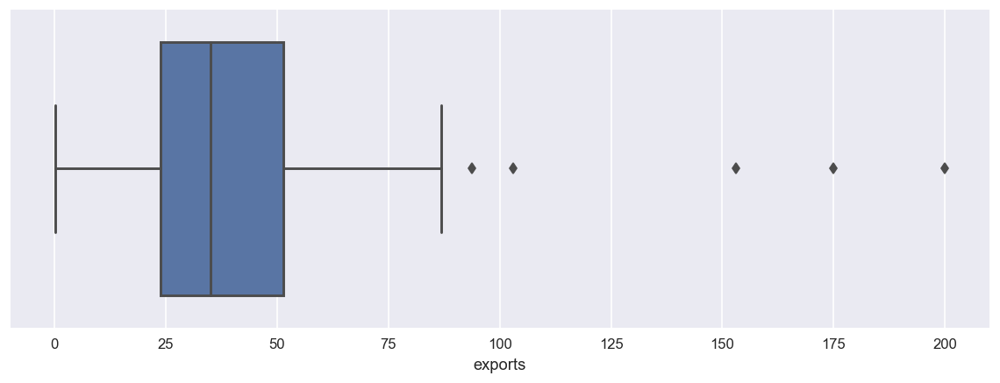

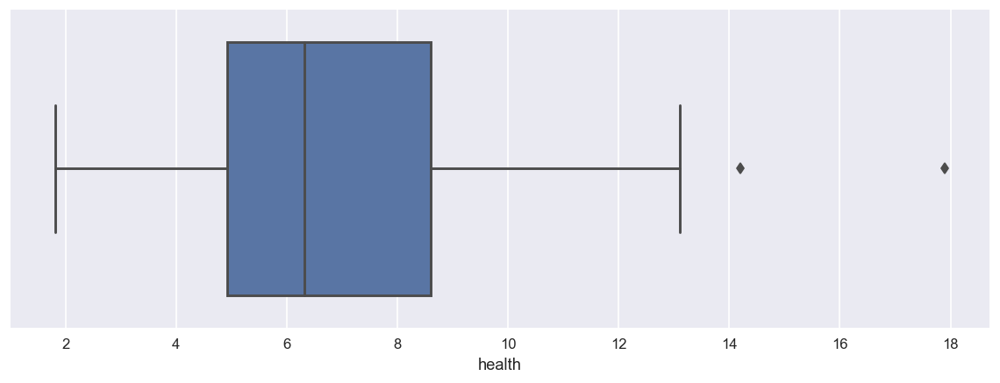

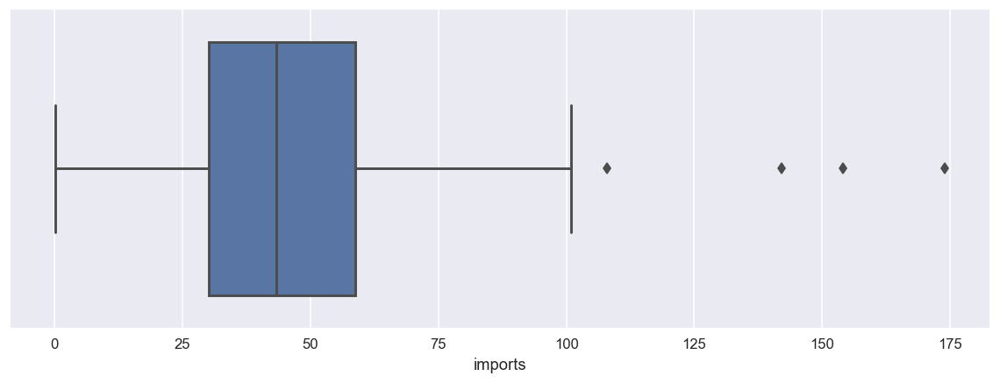

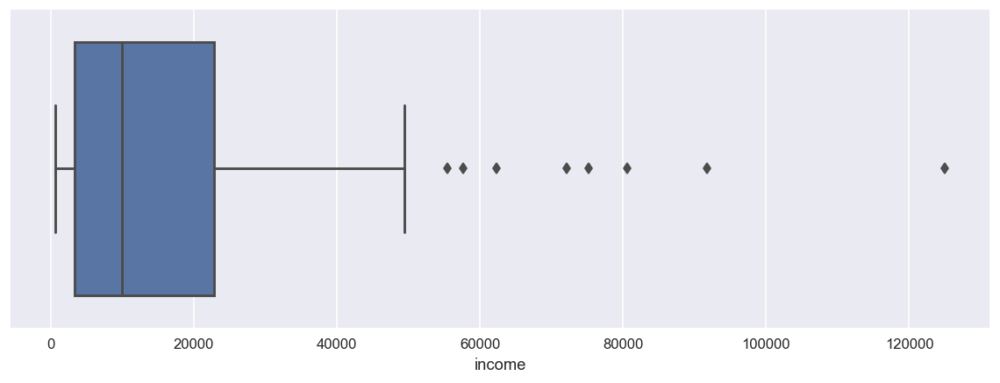

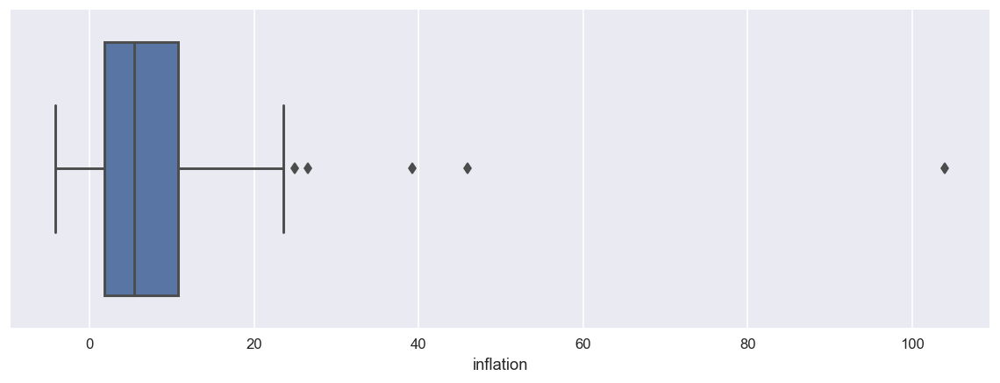

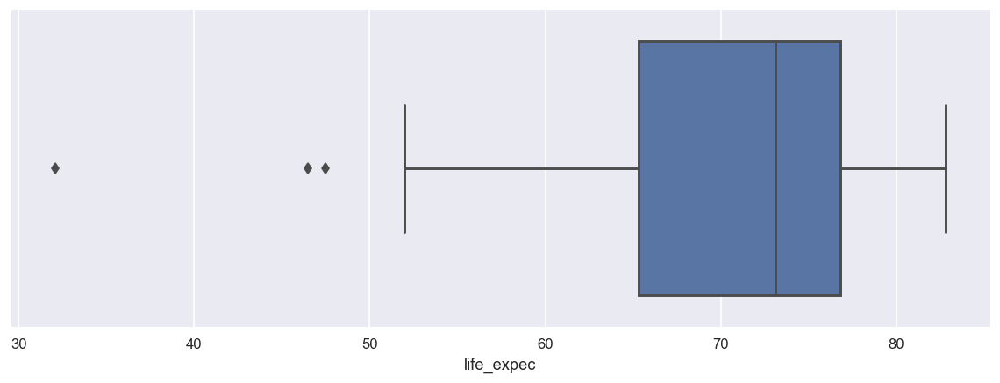

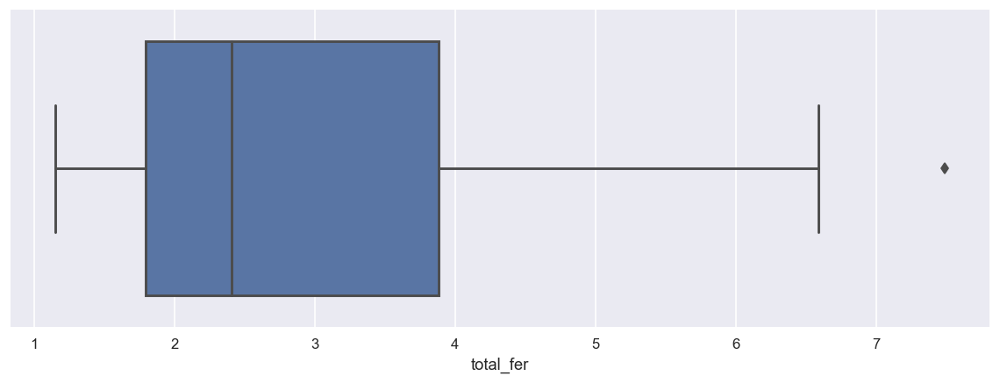

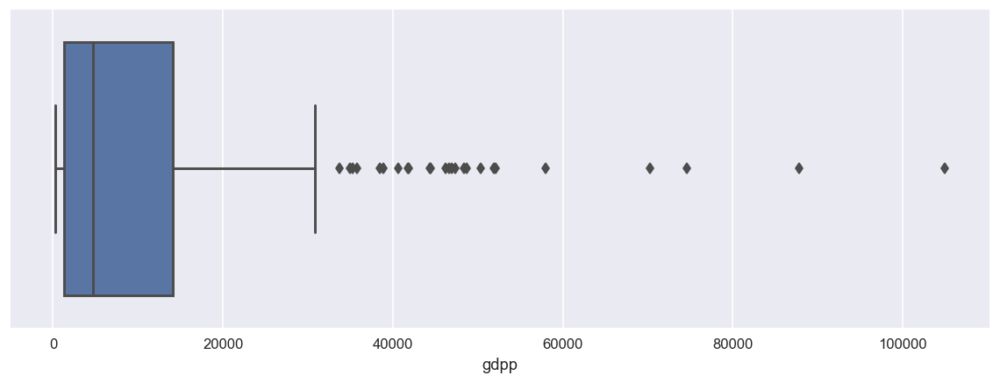

In [6]:
i = 1
while i < len(data.columns):
    try:
        fig = plt.figure(figsize = (12, 4), dpi = 120)
        sns.boxplot(x = data.columns[i], data = data)
        i += 1
    except:
        continue
plt.show()

* **Box Plots Interpretations**

--- **child_mort** : There is a sample with the value more than 200, and it's an outlier.

--- **exports** : Values more than 150 are relatively far from other samples, but they are not much further to be conseidered as outliers.

--- **health** : The only value more than 18 might be an outlier.

--- **imports** : None of the samples seems to be an outlier.

--- **income** : Values more than 120000 seem like outliers.

--- **inflation** : There are some suspicious values less than 0 that need further analysis. Also, samples with values more than 100 are quite distant from the rest of the samples.

--- **life_expec** : Values less than 40 seems like noise.

--- **total_fer** : Nothing unusual is on this column.

--- **gdpp** : Samples with values more than 80000 need more analysis.

#### **Handling Noises**

In [ ]:
i = 9  # Change i to check different feaures. (min = 1, max = 9)
plt.figure(figsize = (16, 4), dpi = 120)
sns.boxplot(x = data.columns[i], data = data)
plt.show()

##### Output of this cell has been cleared aiming to reduce the size of this notebook.

In [8]:
indices = data['child_mort'].nlargest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
66,Haiti,208.0,15.3,6.91,64.7,1500,5.45,32.1,3.33,662
132,Sierra Leone,160.0,16.8,13.10,34.5,1220,17.20,55.0,5.20,399
32,Chad,150.0,36.8,4.53,43.5,1930,6.39,56.5,6.59,897
31,Central African Republic,149.0,11.8,3.98,26.5,888,2.01,47.5,5.21,446
97,Mali,137.0,22.8,4.98,35.1,1870,4.37,59.5,6.55,708


--- **child_mort** : Comparing the *child_mort* rate with the data from *worldbank*, it seems that these values are not real. Highest under-5 mortality rate in 2020 is for *Somalia* with 115 death per 1000. Considering this, this data is either way outdated or it is not reflecting real values. As a result, None of the samples above can be considered as a noise!

In [9]:
indices = data['exports'].nlargest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
133,Singapore,2.8,200.0,3.96,174.0,72100,-0.046,82.7,1.15,46600
91,Luxembourg,2.8,175.0,7.77,142.0,91700,3.620,81.3,1.63,105000
98,Malta,6.8,153.0,8.65,154.0,28300,3.830,80.3,1.36,21100
73,Ireland,4.2,103.0,9.19,86.5,45700,-3.220,80.4,2.05,48700
131,Seychelles,14.4,93.8,3.40,108.0,20400,-4.210,73.4,2.17,10800


--- **exports** : These values are close to recent real values, and none of them is noise.

In [10]:
indices = data['health'].nlargest(3).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
159,United States,7.3,12.4,17.9,15.8,49400,1.22,78.7,1.93,48400
101,"Micronesia, Fed. Sts.",40.0,23.5,14.2,81.0,3340,3.80,65.4,3.46,2860
132,Sierra Leone,160.0,16.8,13.1,34.5,1220,17.20,55.0,5.20,399


--- **health** : The difference between the largest values and the rest is not much. The only notable thing about the column *health* is that *Sierra Leone* has the third largest value, while it has also the second largest value in *child_mort* column! Also, the real data at the *data.worldbank* shows that the health expenditure of *Sierra Loene* is no way near the top!

In [11]:
indices = data['imports'].nlargest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
133,Singapore,2.8,200.0,3.96,174.0,72100,-0.046,82.7,1.15,46600
98,Malta,6.8,153.0,8.65,154.0,28300,3.830,80.3,1.36,21100
91,Luxembourg,2.8,175.0,7.77,142.0,91700,3.620,81.3,1.63,105000
131,Seychelles,14.4,93.8,3.40,108.0,20400,-4.210,73.4,2.17,10800
87,Lesotho,99.7,39.4,11.10,101.0,2380,4.150,46.5,3.30,1170


--- **imports** : The values of the *imports* column are also based on the real values, and they are not in contrast with the recent values.

In [12]:
indices = data['income'].nlargest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
123,Qatar,9.0,62.3,1.81,23.8,125000,6.980,79.5,2.07,70300
91,Luxembourg,2.8,175.0,7.77,142.0,91700,3.620,81.3,1.63,105000
23,Brunei,10.5,67.4,2.84,28.0,80600,16.700,77.1,1.84,35300
82,Kuwait,10.8,66.7,2.63,30.4,75200,11.200,78.2,2.21,38500
133,Singapore,2.8,200.0,3.96,174.0,72100,-0.046,82.7,1.15,46600


--- **income** : Comparing the values with the the recent values, there are some suspicious samples. Based on the real data, net income per person for *Qatar* is far less than it's related value on the data that we have. Also, *Brunei* is not near the top at all! However other values are also more than the real values, their correlations with each other are true.

In [13]:
indices = data['inflation'].nlargest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
113,Nigeria,130.0,25.3,5.07,17.4,5150,104.0,60.5,5.84,2330
163,Venezuela,17.1,28.5,4.91,17.6,16500,45.9,75.4,2.47,13500
103,Mongolia,26.1,46.7,5.44,56.7,7710,39.2,66.2,2.64,2650
149,Timor-Leste,62.6,2.2,9.12,27.8,1850,26.5,71.1,6.23,3600
49,Equatorial Guinea,111.0,85.8,4.48,58.9,33700,24.9,60.9,5.21,17100


In [14]:
mask = data['inflation'] < 0
data[mask].sort_values(by = 'inflation')

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
131,Seychelles,14.4,93.8,3.40,108.0,20400,-4.210,73.4,2.17,10800
73,Ireland,4.2,103.0,9.19,86.5,45700,-3.220,80.4,2.05,48700
77,Japan,3.2,15.0,9.49,13.6,35800,-1.900,82.8,1.39,44500
43,Czech Republic,3.4,66.0,7.88,62.9,28300,-1.430,77.5,1.51,19800
135,Slovenia,3.2,64.3,9.41,62.9,28700,-0.987,79.5,1.57,23400
85,Latvia,7.8,53.7,6.68,55.1,18300,-0.812,73.1,1.36,11300
10,Bahamas,13.8,35.0,7.89,43.7,22900,-0.393,73.8,1.86,28000
133,Singapore,2.8,200.0,3.96,174.0,72100,-0.046,82.7,1.15,46600


--- **inflation** : Most of the values on the *inflation* column are not based on the most recent values that can be found on *data.worldbank*, and thus, none of them can cinsidered as a noise scientific wise. However, the gap between the *Nigeria* and other values is too big, and also it's real inflation rate is around 11.5, so it might be an error!

In [15]:
indices = data['life_expec'].nsmallest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
66,Haiti,208.0,15.3,6.91,64.7,1500,5.45,32.1,3.33,662
87,Lesotho,99.7,39.4,11.10,101.0,2380,4.15,46.5,3.30,1170
31,Central African Republic,149.0,11.8,3.98,26.5,888,2.01,47.5,5.21,446
166,Zambia,83.1,37.0,5.89,30.9,3280,14.00,52.0,5.40,1460
94,Malawi,90.5,22.8,6.59,34.9,1030,12.10,53.1,5.31,459


--- **life_expec** : Seeing *Haiti* at the bottom, as the country with the lowest life expectency, is something that is not based on real values. The problem is that the order of other countires are quite like the real values recorded in recent years, but the life expectency of *Haiti* is much more and it is not even near the 32.1! The actual life expectency of *Haiti* recorded in 2019 is 64 years!

In [16]:
indices = data['gdpp'].nlargest(5).index
data.iloc[indices]

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
91,Luxembourg,2.8,175.0,7.77,142.0,91700,3.620,81.3,1.63,105000
114,Norway,3.2,39.7,9.48,28.5,62300,5.950,81.0,1.95,87800
145,Switzerland,4.5,64.0,11.50,53.3,55500,0.317,82.2,1.52,74600
123,Qatar,9.0,62.3,1.81,23.8,125000,6.980,79.5,2.07,70300
44,Denmark,4.1,50.5,11.40,43.6,44000,3.220,79.5,1.87,58000


--- **gdpp** : None of the values can be removed with scientific reasons.

--- All in all, at least 3 countries are need to be excluded considering the real values and the order of countries based on real values. 

--- *Sierra Leone* for too high value for *health*, index = 132

--- *Nigeria* for too high value for *inflation*, index = 113

--- *Haiti* for too low value for *life_expec*, index = 66

--- In addition, there are some outliers that could be exluded from the data during the modeling process, and be added to the data afterwards.

--- *Qatar* for too high value for *income*, index = 123

In [17]:
df_1 = data.drop([132, 113, 66])
df_1.reset_index(drop = True, inplace = True)
df_1

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
0,Afghanistan,90.2,10.0,7.58,44.9,1610,9.44,56.2,5.82,553
1,Albania,16.6,28.0,6.55,48.6,9930,4.49,76.3,1.65,4090
2,Algeria,27.3,38.4,4.17,31.4,12900,16.10,76.5,2.89,4460
3,Angola,119.0,62.3,2.85,42.9,5900,22.40,60.1,6.16,3530
4,Antigua and Barbuda,10.3,45.5,6.03,58.9,19100,1.44,76.8,2.13,12200
...,...,...,...,...,...,...,...,...,...,...
159,Vanuatu,29.2,46.6,5.25,52.7,2950,2.62,63.0,3.50,2970
160,Venezuela,17.1,28.5,4.91,17.6,16500,45.90,75.4,2.47,13500
161,Vietnam,23.3,72.0,6.84,80.2,4490,12.10,73.1,1.95,1310
162,Yemen,56.3,30.0,5.18,34.4,4480,23.60,67.5,4.67,1310


In [18]:
df_2 = data.drop([132, 113, 66, 123])
df_2.reset_index(drop = True, inplace = True)
df_2

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
0,Afghanistan,90.2,10.0,7.58,44.9,1610,9.44,56.2,5.82,553
1,Albania,16.6,28.0,6.55,48.6,9930,4.49,76.3,1.65,4090
2,Algeria,27.3,38.4,4.17,31.4,12900,16.10,76.5,2.89,4460
3,Angola,119.0,62.3,2.85,42.9,5900,22.40,60.1,6.16,3530
4,Antigua and Barbuda,10.3,45.5,6.03,58.9,19100,1.44,76.8,2.13,12200
...,...,...,...,...,...,...,...,...,...,...
158,Vanuatu,29.2,46.6,5.25,52.7,2950,2.62,63.0,3.50,2970
159,Venezuela,17.1,28.5,4.91,17.6,16500,45.90,75.4,2.47,13500
160,Vietnam,23.3,72.0,6.84,80.2,4490,12.10,73.1,1.95,1310
161,Yemen,56.3,30.0,5.18,34.4,4480,23.60,67.5,4.67,1310


--- data : All samples 

--- df_1 : Noises are excluded

--- df_2 : Noises and outliers are excluded.

#### **Data Visualization - 2**

In [ ]:
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde')

##### Output of this cell has been cleared aiming to reduce the size of this notebook.

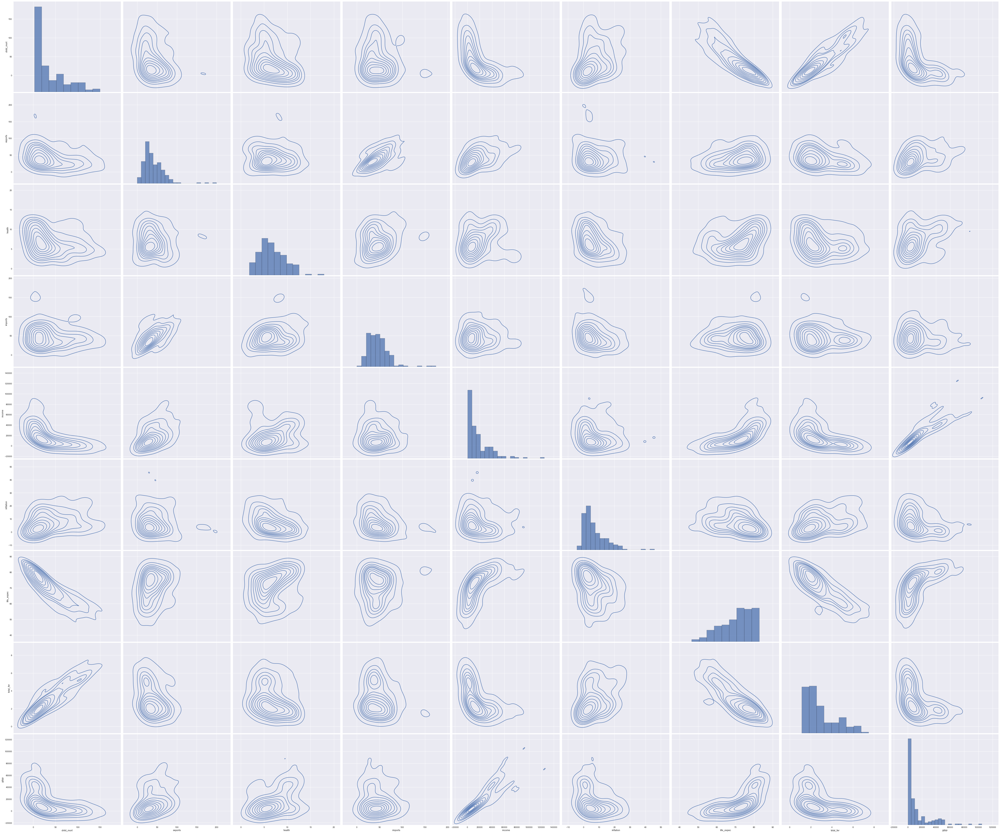

In [20]:
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'kde', diag_kind = 'hist')

--- Observing the scatter plots, it can be concluded that the samples can be put into 2 clusters. However, because of the number of features, a better approach for visualization is using principle components aiming to get a better insight about the data.

--- Based on the kde plots, samples have 2 high density areas along the feature *total_fer*.

In [21]:
# Normalizing data before using PCA.

features = data.columns[1:]
scaler = StandardScaler()
data_norm = scaler.fit_transform(df_1[features])
df_norm = pd.DataFrame(data_norm, columns = features)
df_norm

,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp
0,1.491673,-1.149674,0.291807,-0.088349,-0.819000,0.306632,-1.777945,1.943325,-0.687446
1,-0.531439,-0.492946,-0.087421,0.064619,-0.387738,-0.356733,0.645483,-0.845530,-0.494892
2,-0.237318,-0.113503,-0.963696,-0.646478,-0.233790,1.199159,0.669597,-0.016230,-0.474750
3,2.283325,0.758486,-1.449697,-0.171035,-0.596630,2.043441,-1.307728,2.170714,-0.525379
4,-0.704613,0.145539,-0.278876,0.490451,0.087583,-0.765473,0.705767,-0.524511,-0.053385
...,...,...,...,...,...,...,...,...,...
159,-0.185091,0.185673,-0.566059,0.234125,-0.749542,-0.607337,-0.958079,0.391732,-0.555865
160,-0.517695,-0.474704,-0.691241,-1.217010,-0.047186,5.192748,0.536971,-0.297122,0.017387
161,-0.347270,1.112389,0.019352,1.371055,-0.669717,0.663106,0.259664,-0.644893,-0.646235
162,0.559832,-0.419976,-0.591831,-0.522450,-0.670235,2.204257,-0.415520,1.174217,-0.646235


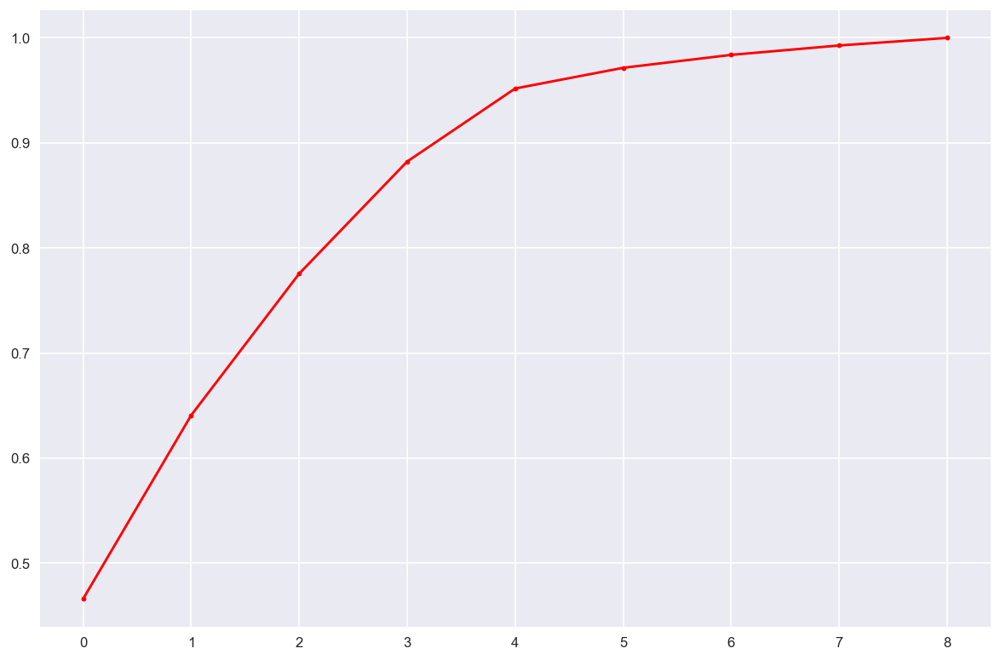

In [22]:
# Ploting the expalined_variance_ratio aiming to get some info about how much of the variance in the data
# can be preserved.

pca = PCA().fit(df_norm)
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(np.cumsum(pca.explained_variance_ratio_), color = 'red', marker = '.')
plt.show()

--- It can be seen that using 2 components can yield about 78 percent of the information of the original data. Increasing the components to 3, more than 85 percent of the information is preserved. Also, with 4 components, about 95 percent of the variance of the original data is preserved.

In [23]:
pca = PCA(n_components = 2)
principal_components = pca.fit_transform(df_norm)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])
df_pca

,pca_1,pca_2
0,-3.100473,0.100715
1,0.425643,-0.619234
2,-0.422125,-0.432024
3,-3.314141,1.782224
4,1.041357,0.122285
...,...,...
159,-0.897972,0.622183
160,-0.902593,-1.160862
161,0.390712,1.366422
162,-2.137440,-0.075698


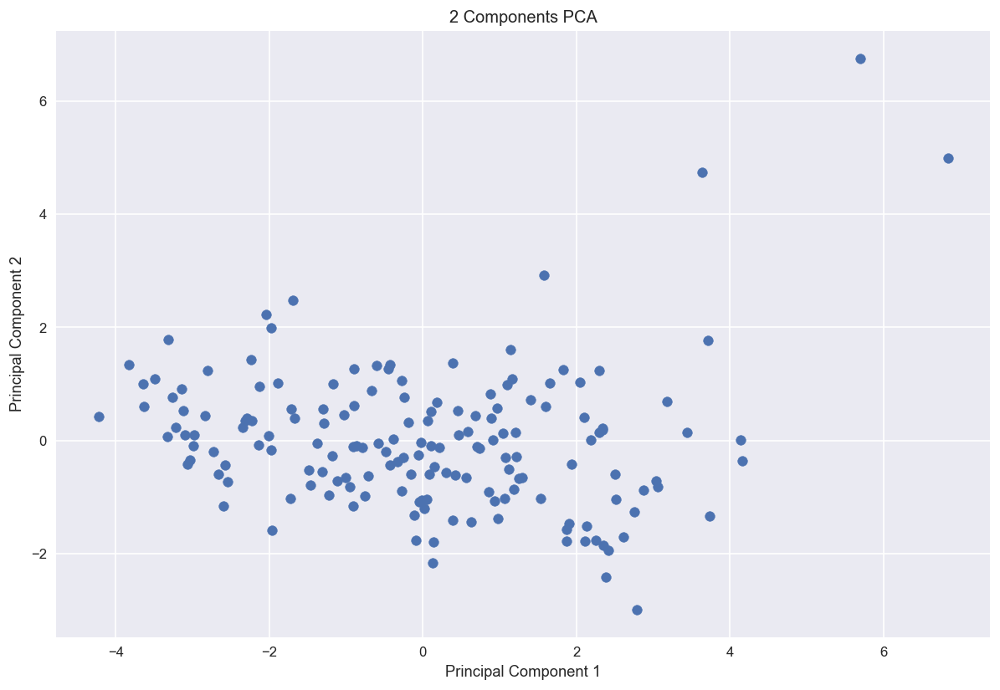

In [24]:
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'])
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.show()

--- Based on the plot above, derived from PCA with 2 components, 2 or 3 clusters can represent the data to a good extent. However, it should not be neglected that less than 80 percent of the information is available with 2 components, so it might not be accurate enough.

In [25]:
pca = PCA(n_components = 3)
principal_components = pca.fit_transform(df_norm)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2', 'pca_3'])
df_pca

,pca_1,pca_2,pca_3
0,-3.100473,0.100715,-0.847514
1,0.425643,-0.619234,-0.202882
2,-0.422125,-0.432024,1.561665
3,-3.314141,1.782224,1.652010
4,1.041357,0.122285,-0.238715
...,...,...,...
159,-0.897972,0.622183,-0.446636
160,-0.902593,-1.160862,4.201129
161,0.390712,1.366422,0.049690
162,-2.137440,-0.075698,1.493259


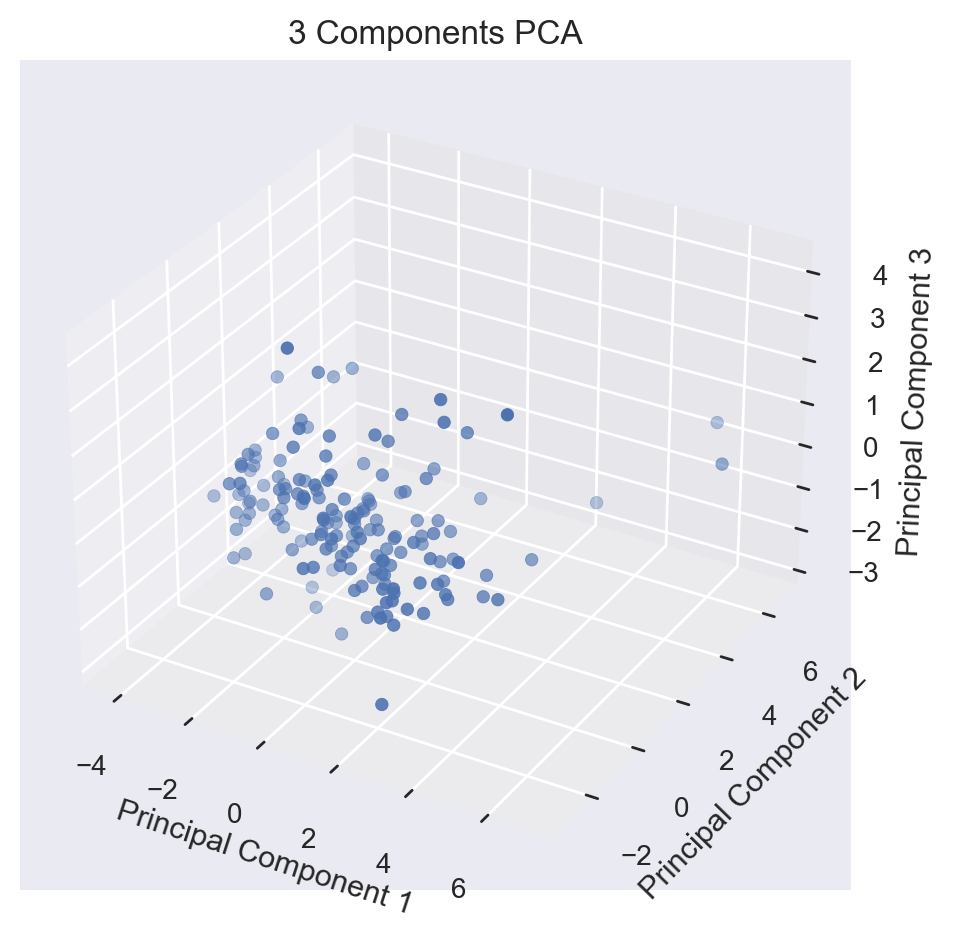

In [26]:
fig = plt.figure(dpi = 200)
ax = fig.add_subplot(projection='3d')
ax.scatter(df_pca['pca_1'], df_pca['pca_2'], df_pca['pca_3'])
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.title('3 Components PCA')
plt.show()

--- Using 3 components in order to get more than 85 percent of the information in the data, it can be a not so accurate initial guess that 3 clusters might be the best for the samples of this data.

In [ ]:
fig, ax = plt.subplots(figsize = (24, 18), dpi = 200)
sns.heatmap(df_1[features].corr(), center = 1, cbar = True, annot = True, linewidths = 0.5, ax = ax)
plt.show()

##### Output of this cell has been cleared aiming to reduce the size of this notebook.
--- As it can be seen above, there are some highly correlated pair of features. 

--- *total_fer* and *child_mort* : 89 %

--- *income* and *gpdd* : 89 %

--- *life_expec* and *child_mort* : -87 %

--- *total_fer* and *life_expec* : -80 %

--- *imports* and *exports* : 74 %

--- Because of these pairs, may multicollinearity be a problem for fitting a model on the data!

### **Part 2 : Machine Learning**

#### **K-Means**

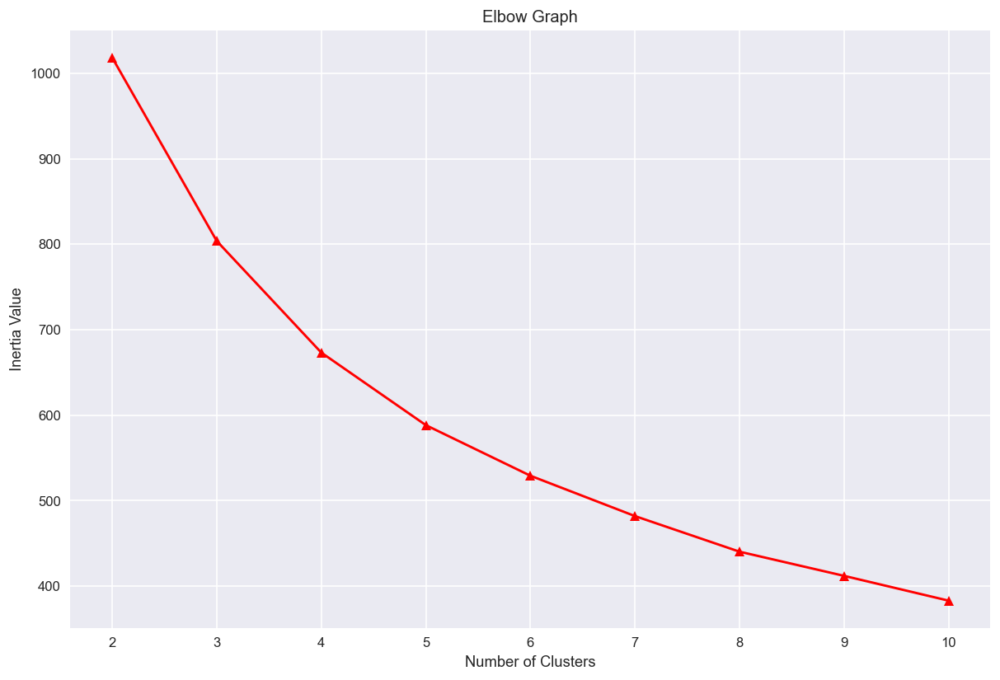

In [28]:
kmeans_constants = {'n_init' : 100, 'random_state' : 1}
inertia_values = []

for k in range(2, 11):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    model = KMeans(n_clusters = k, **kmeans_constants)
    model.fit(X)
    inertia_values.append(model.inertia_)
    
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(range(2, 11), inertia_values, color = 'r', marker = '^')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia Value')
plt.title('Elbow Graph')
plt.show()

In [29]:
kl = KneeLocator(range(2, 11), inertia_values, curve = 'convex', direction = 'decreasing')
kl.elbow

5

--- Based on the elbow graph method, the optimum number of clusters is 5. However, without using KneeLocator, it seems that 4 is a better number of clusters.

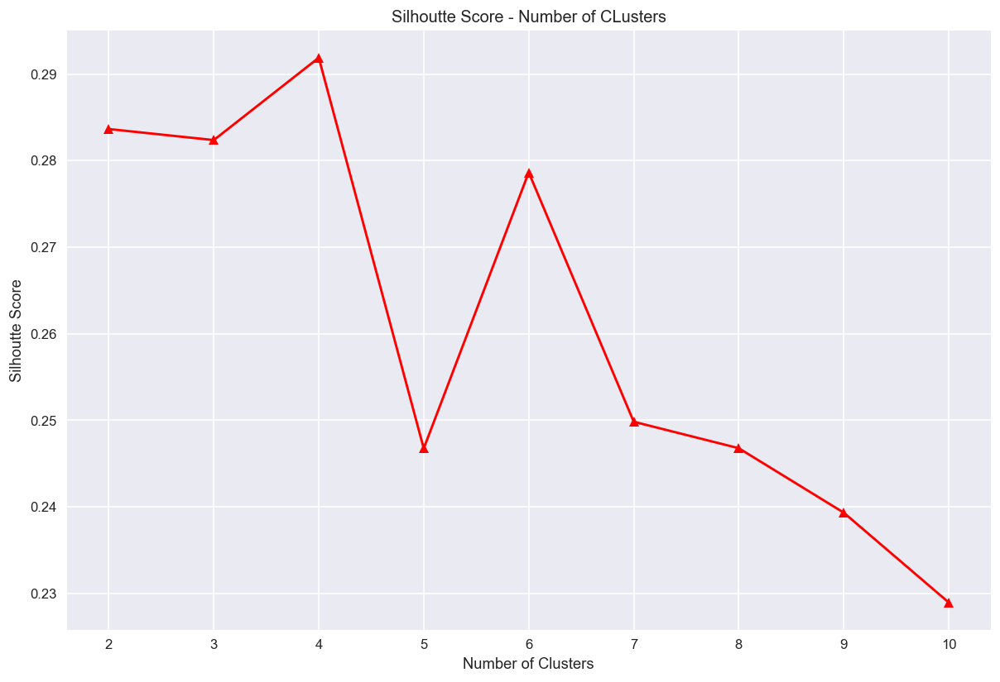

In [30]:
kmeans_constants = {'n_init' : 100, 'random_state' : 1}
silhoutte_coefs = []

for k in range(2, 11):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    model = KMeans(n_clusters = k, **kmeans_constants)
    model.fit(X)
    silhoutte_coefs.append(metrics.silhouette_score(X, model.labels_))
    
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(range(2, 11), silhoutte_coefs, color = 'r', marker = '^')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhoutte Score')
plt.title('Silhoutte Score - Number of CLusters')
plt.show()

--- It can be seen that by setting the numbe of clusters to 4, the performance of the model is significantlly better than any other number of clusters.

In [31]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = KMeans(n_clusters = 4, **kmeans_constants)
model.fit(X)

KMeans(n_clusters=4, n_init=100, random_state=1)

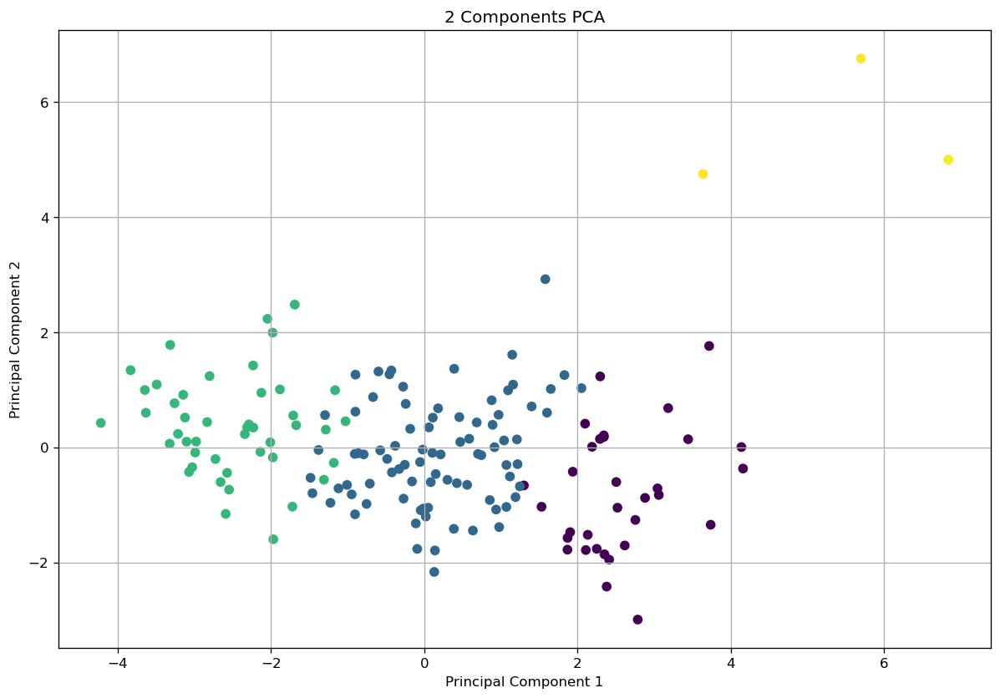

In [32]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

--- Cosidering the chart above, it seems that KMeans performs well enough on this data. On the area with higher density of samples, samples which are violet are well seperarted from other clusters. Also, the outliers are classified into a different cluster and it probably the outliers of this data are not much of a problem for KMeans. The only downside of this clustering is that the samples in green and blue, are so close and there is not a clear border between them. However, it should not be neglected that using 2 components yields less than 80 percent of the original information, which may be the underlying reason of this problem.

In [33]:
print('Inertia : ', model.inertia_)
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Inertia :  673.2141512740895
Silhouette Score :  0.29188878378474836
CH Score :  63.59825500452129
DB Score :  1.065355462154734


In [34]:
print('Inertia : ', model.inertia_)
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Inertia :  673.2141512740895
Silhouette Score :  0.2026204692139129
CH Score :  122.51580459902506
DB Score :  1.7400448047601627


--- Evaluating the model on the normalized data gives better results, but using raw data shows poor performance! Aiming to get a better insight, pairplots are being analyzed.

In [ ]:
df_1['clusters'] = model.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')

##### Output of this cell has been cleared aiming to reduce the size of this notebook.
--- Inspecting the non-normalized scatter plot, it can be concluded that the clustering is not good enough. Along non of the features, clusters are well-separable, only in some of them, one or two clusters are seperated and others do not have any clear border!

--- Inspecting the results of KMeans precisely, I believe that centroid based algorithms can be good choices for this data, and the only problem with KMeans might be the spherical shape of clusters. Aiming to change it for better, MeanShift algorithm is being implemented.

#### **Mean Shift**

In [36]:
del df_1['clusters']

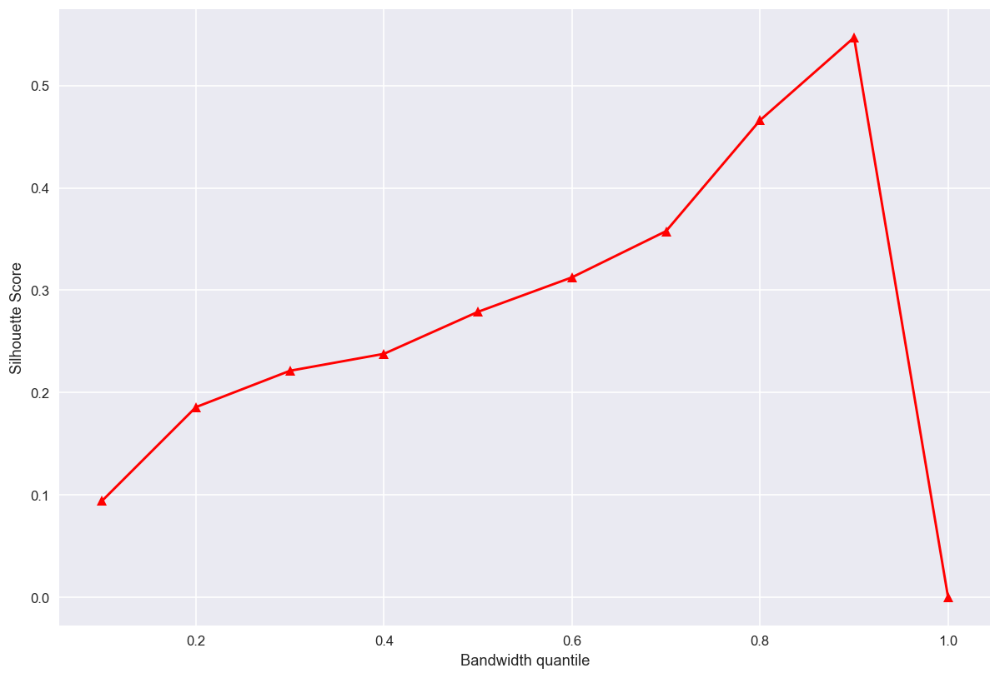

In [37]:
silhouette_scores = []
for quantile in np.arange(0.1, 1.1, 0.1):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    bandwidth = estimate_bandwidth(X, quantile = quantile, random_state = 1, n_jobs = -1)
    model = MeanShift(bandwidth = bandwidth, cluster_all = False, n_jobs = -1)
    model.fit(X)
    try:
        silhouette_scores.append(metrics.silhouette_score(X, model.labels_))
    except:
        silhouette_scores.append(0)

plt.style.use('seaborn')
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(np.arange(0.1, 1.1, 0.1), silhouette_scores, color = 'r', marker = '^')
plt.xlabel('Bandwidth quantile')
plt.ylabel('Silhouette Score')
plt.show()

--- While setting *n_samples* parameter of *estimate_bandwidth* function to *None*, which results in considering all samples for finding the bandwidth, optimum value for *quantile* parameter is 0.9. Note that because of the outliers, the parameter *cluster_all* of *MeanShift* algorithm has been set to *False*.

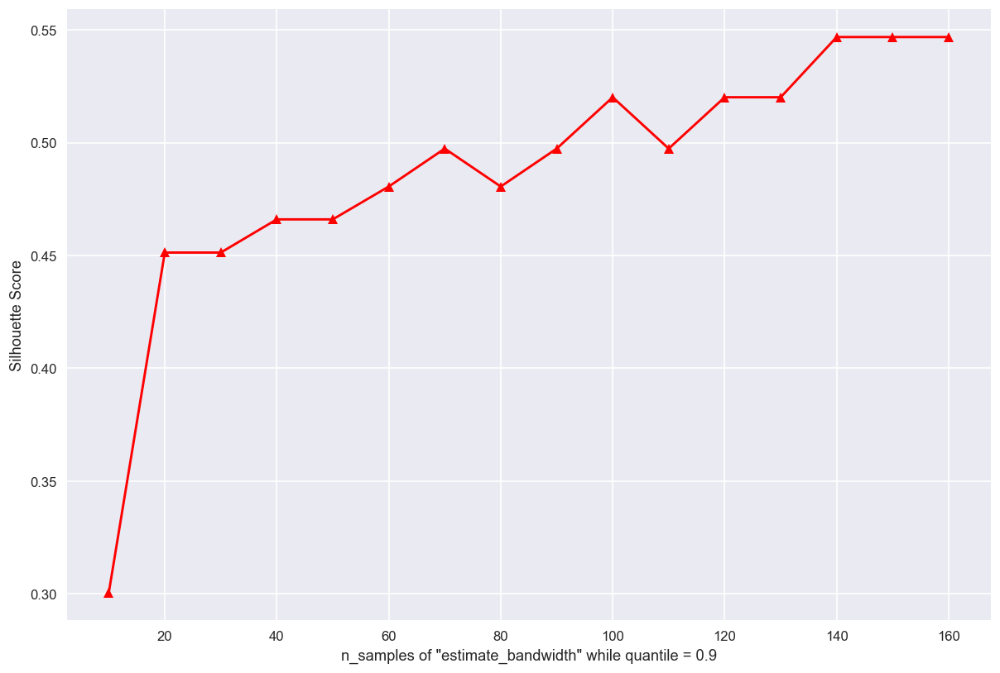

In [38]:
silhouette_scores = []
for n_samples in range(10, 170, 10):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    bandwidth = estimate_bandwidth(X, quantile = 0.9, n_samples = n_samples, random_state = 1, n_jobs = -1)
    model = MeanShift(bandwidth = bandwidth, cluster_all = False, n_jobs = -1)
    model.fit(X)
    try:
        silhouette_scores.append(metrics.silhouette_score(X, model.labels_))
    except:
        silhouette_scores.append(0)

plt.style.use('seaborn')
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(range(10, 170, 10), silhouette_scores, color = 'r', marker = '^')
plt.xlabel('n_samples of "estimate_bandwidth" while quantile = 0.9')
plt.ylabel('Silhouette Score')
plt.show()

--- It can be seen that the model perfroms better while all samples are being considered for finding the optimum bandwidth

In [39]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
bandwidth = estimate_bandwidth(X, quantile = 0.90, random_state = 1, n_jobs = -1)
model = MeanShift(bandwidth = bandwidth, cluster_all = False, n_jobs = -1)
model.fit(X)

MeanShift(bandwidth=5.599717856141231, cluster_all=False, n_jobs=-1)

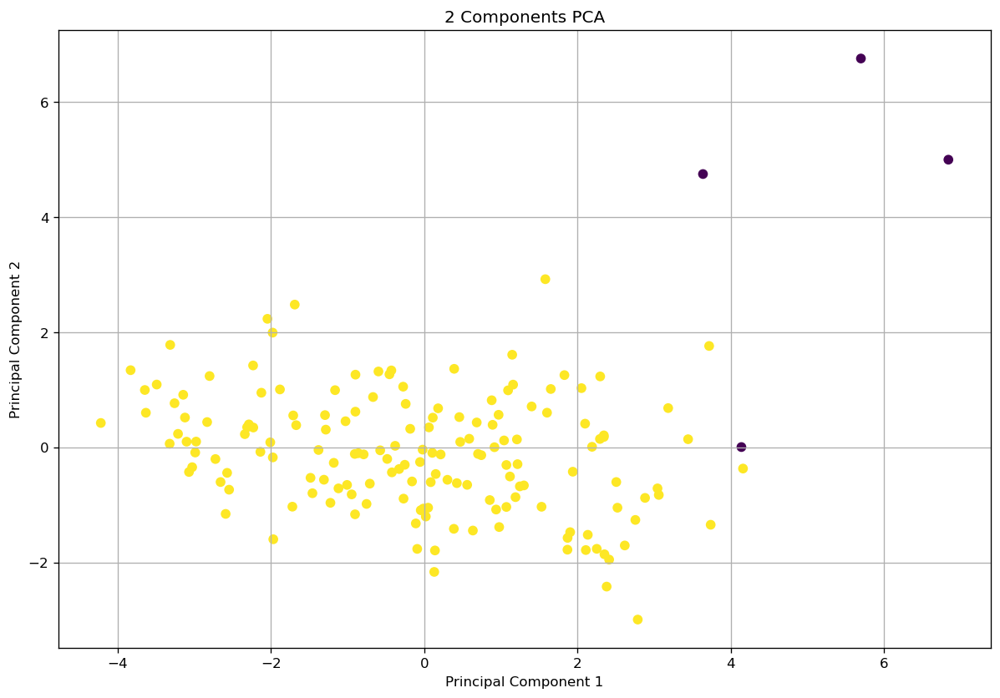

In [40]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

--- Based on the plot above, the better *Silhouette score* of MeanShift algorithm is stemmed from clstering all samples in just one cluster, except outliers. Considering that our goal is to find countries which are in need of financial aid, this result is not satisfactory.

--- It should be noted that other values for *n_smaples* has also been checked, the only difference is the number of outliers and not the number of clusters.

#### **Affinity Propagation**

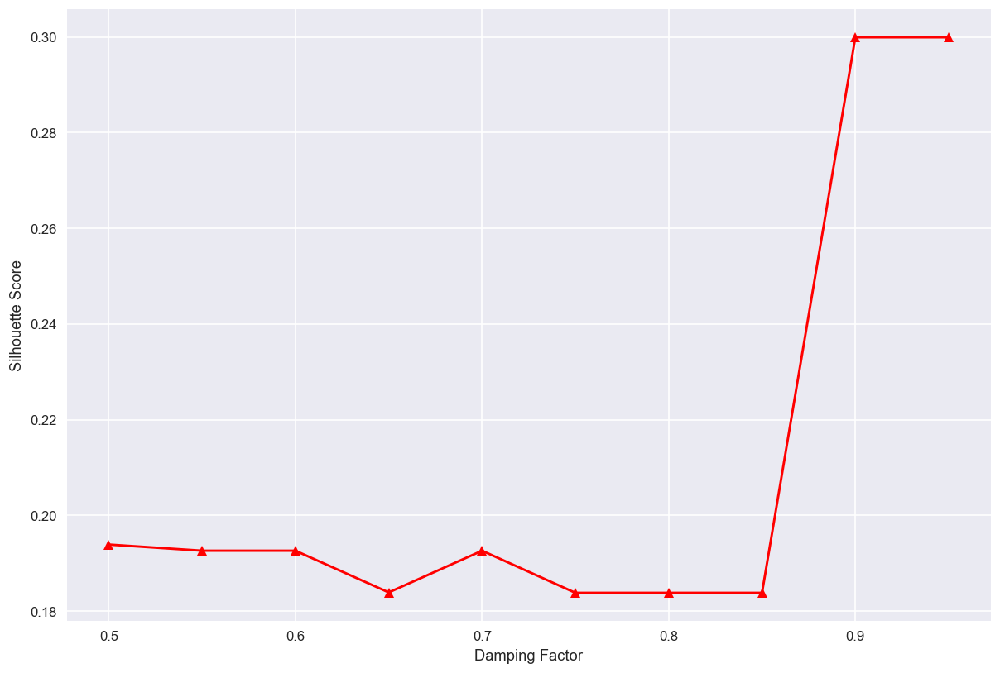

In [41]:
silhouette_scores = []
for damping_factor in np.arange(0.5, 1, 0.05):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    model = AffinityPropagation(damping = damping_factor, random_state = 1)
    model.fit(X)
    try:
        silhouette_scores.append(metrics.silhouette_score(X, model.labels_))
    except:
        silhouette_scores.append(0)

plt.style.use('seaborn')
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(np.arange(0.5, 1, 0.05), silhouette_scores, color = 'r', marker = '^')
plt.xlabel('Damping Factor')
plt.ylabel('Silhouette Score')
plt.show()

--- Without changing *preference*, optimum value for *damping* is 0.9.

In [42]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = AffinityPropagation(damping = 0.9, random_state = 1)
model.fit(X)

AffinityPropagation(damping=0.9, random_state=1)

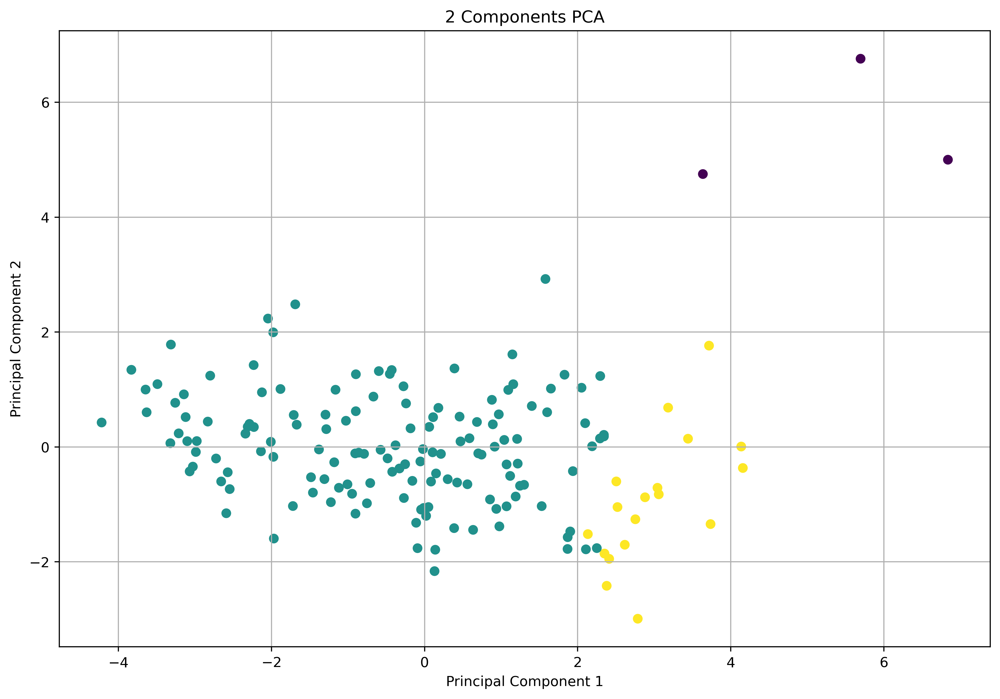

In [43]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 400)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

--- It can be seen that the model excluded the outliers well, and also divided the rest of the data into two clusters. However, on the plot above, it seems that some of the samples in green has not been put into the right clusters.

In [44]:
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Silhouette Score :  0.2999154070518763
CH Score :  33.732680104619924
DB Score :  0.8897111822774549


In [45]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.6487600125176919
CH Score :  100.0897795552249
DB Score :  2.4195484248070103


--- Unlike the results of Kmeans, *Silhouette score* and *Calinski-Harabsz score* are better while evaluating the model using the non-normalized data. For more information pair plot is being analyzed.

In [ ]:
df_1['clusters'] = model.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')

##### Output of this cell has been cleared aiming to reduce the size of this notebook.
--- Clustering using Affinity Propagation has not yeild good results. The number of clusters is less than KMeans, but the integration of different clusters is still too high! 

#### **Agglomerative Clustering**

In [47]:
del df_1['clusters']

--- Up to now we know that the optimum number of clusters is 3 or 4. However, this will be checked again using a dendrogram.

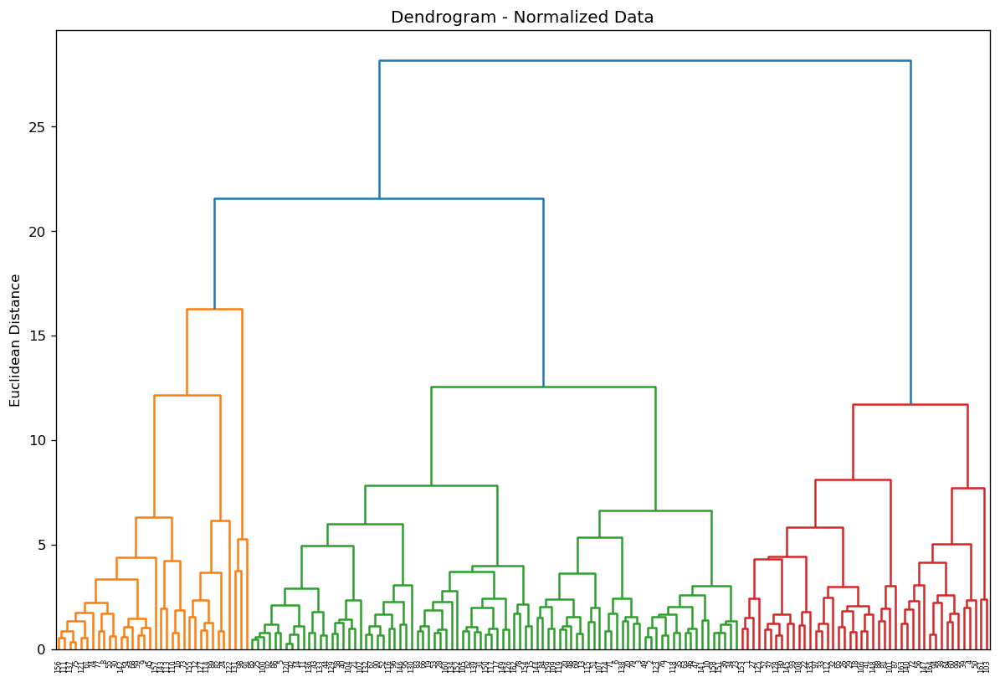

In [48]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])

linked = linkage(X, method = 'ward')

plt.figure(figsize = (12, 8), dpi = 120)
dendrogram(linked, labels = range(1, 165), orientation = 'top', distance_sort = 'descending', show_leaf_counts = True)
plt.ylabel('Euclidean Distance')
plt.title('Dendrogram - Normalized Data')
plt.show()

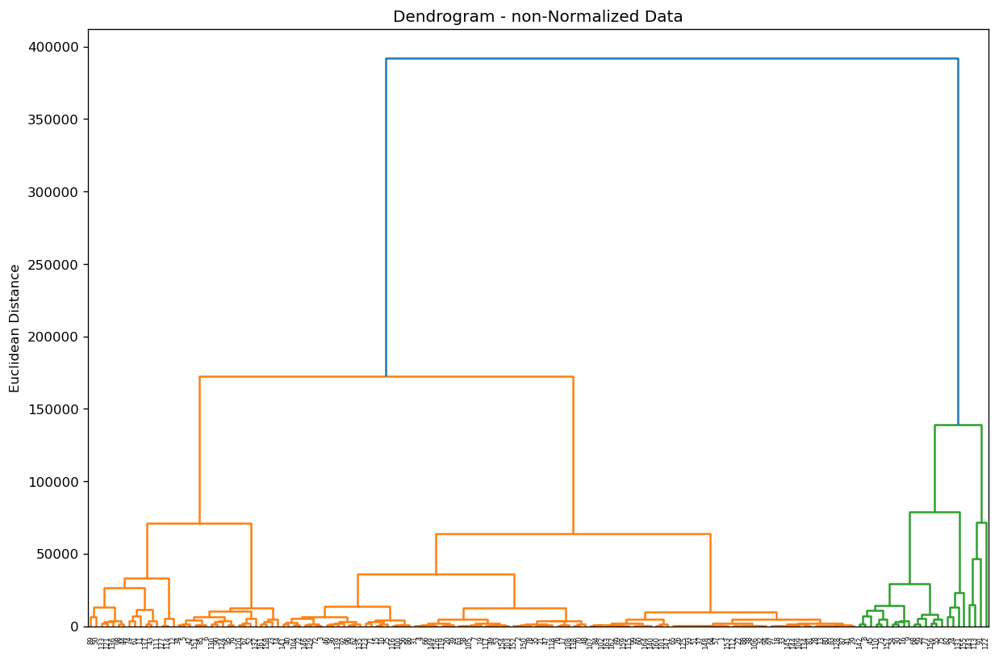

In [49]:
linked = linkage(df_1[features], method = 'ward')
plt.figure(figsize = (12, 8), dpi = 120)
dendrogram(linked, labels = range(1, 165), orientation = 'top', distance_sort = 'descending', show_leaf_counts = True)
plt.ylabel('Euclidean Distance')
plt.title('Dendrogram - non-Normalized Data')
plt.show()

--- Comparing the plots above, it seems that using normalized data to fit a model on, the optimum number of clusters is 3. On the other hand, with raw data, 2 clusters might be a better choice. Aiming to find the best model, 3 models will be examined. Two models using raw data with 2 and 3 clusters, and one on the normalized data with 3 clusters.

##### *2 clusters - non-Normalized Data*

In [50]:
X = df_1[features]
model = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
model.fit(X)

AgglomerativeClustering()

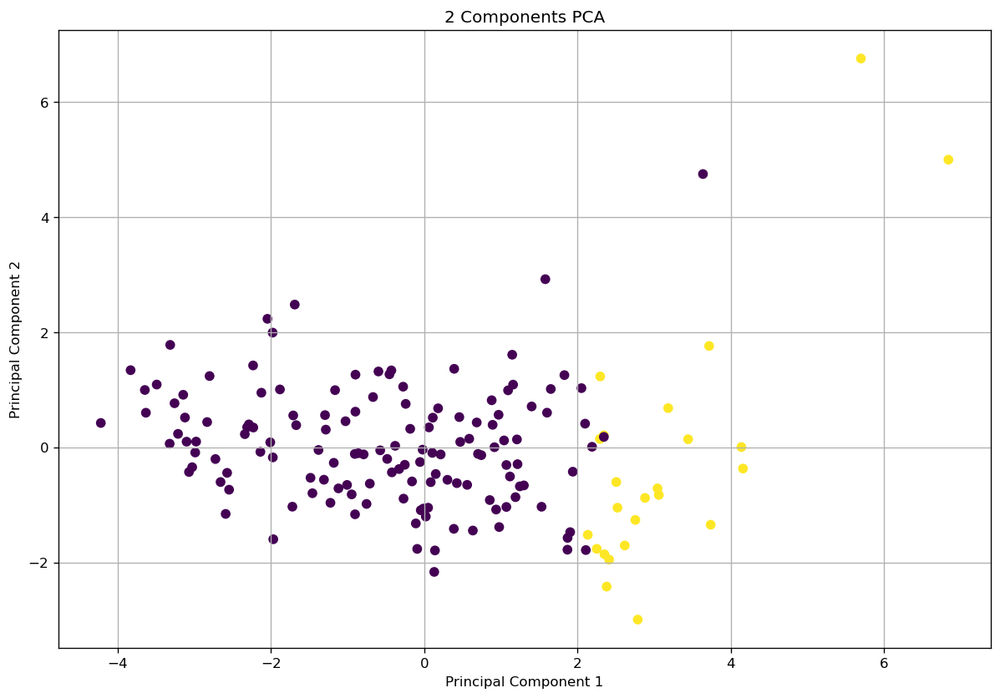

In [51]:
pca = PCA(2)
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [52]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.720047416807443
CH Score :  316.04121313804416
DB Score :  0.5140994252365614


--- It can be seen that the results are significantly better than the previous models. Also, on the plot using 2 components PCA, samples of different clusters are not integrated much and that is a good sign.

In [ ]:
df_1['clusters'] = model.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')

##### Output of this cell has been cleared aiming to reduce the size of this notebook.
--- The results of the scatter plots above are not remarkable, but they are still better than those of Affinity Propagation model.

In [54]:
del df_1['clusters']

##### *3 clusters - non-Normalized Data*

In [55]:
X = df_1[features]
model = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage = 'ward')
model.fit(X)

AgglomerativeClustering(n_clusters=3)

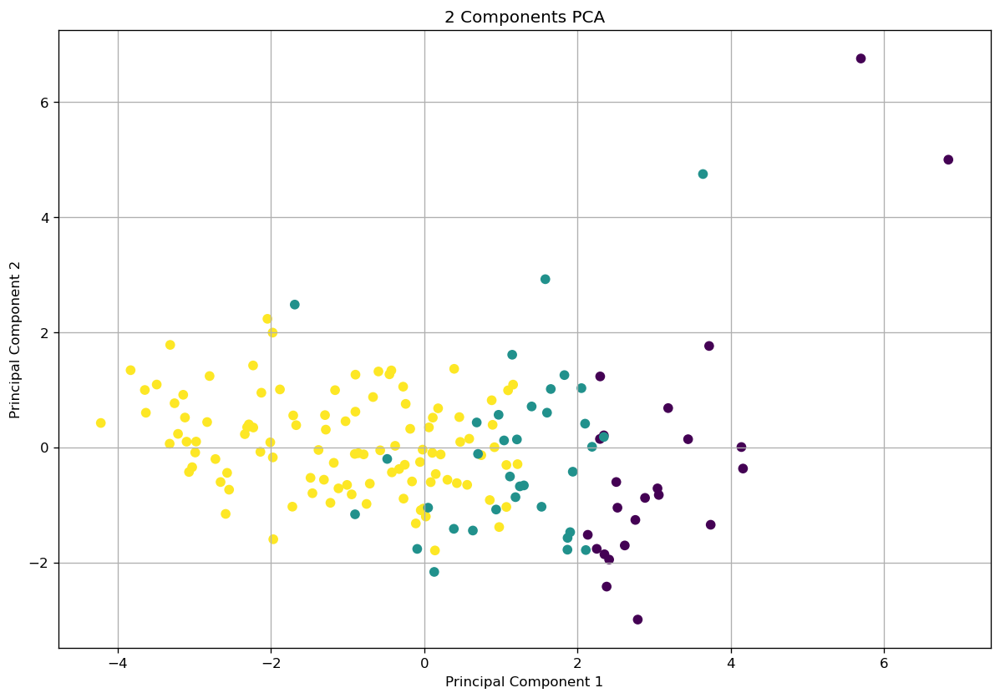

In [56]:
pca = PCA(2)
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [57]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.5917349401217474
CH Score :  301.1297151822335
DB Score :  0.6720330855718967


--- Not the plot using PCA, nor the evaluation results are better than the model with 2 clusters !

##### *3 clusters - Normalized Data*

In [58]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage = 'ward')
model.fit(X)

AgglomerativeClustering(n_clusters=3)

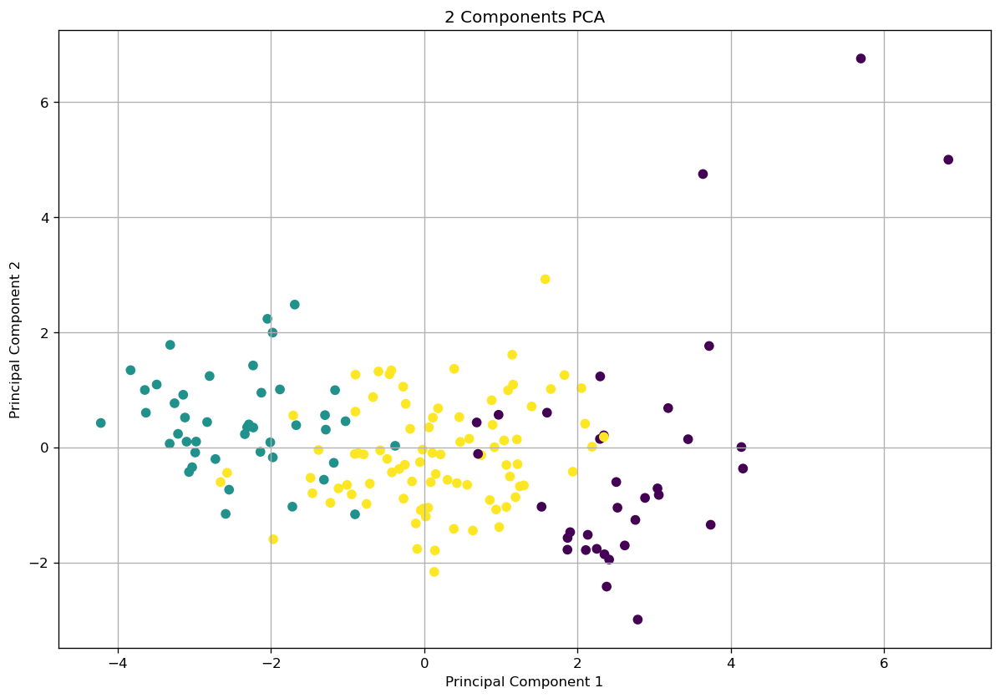

In [59]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [60]:
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Silhouette Score :  0.2683975786885166
CH Score :  59.89649814377869
DB Score :  1.3553539812021764


In [61]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.19210729639871316
CH Score :  176.6861854871469
DB Score :  1.120858292942307


--- However the plot using PCA is not too bad, the results of evaluation on both normalized and non-normalized data are much worse that the 2 other models using Agglomerative Clustering method!

--- Best model in this section is the one with 2 clusters fitted on the non-normalized data.

#### **DBSCAN**

--- For this algorithm, first we need to find the optimum values of the hyperparameters.

In [62]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
neighbors = NearestNeighbors(n_neighbors = 2)
neighbors.fit(X)

NearestNeighbors(n_neighbors=2)

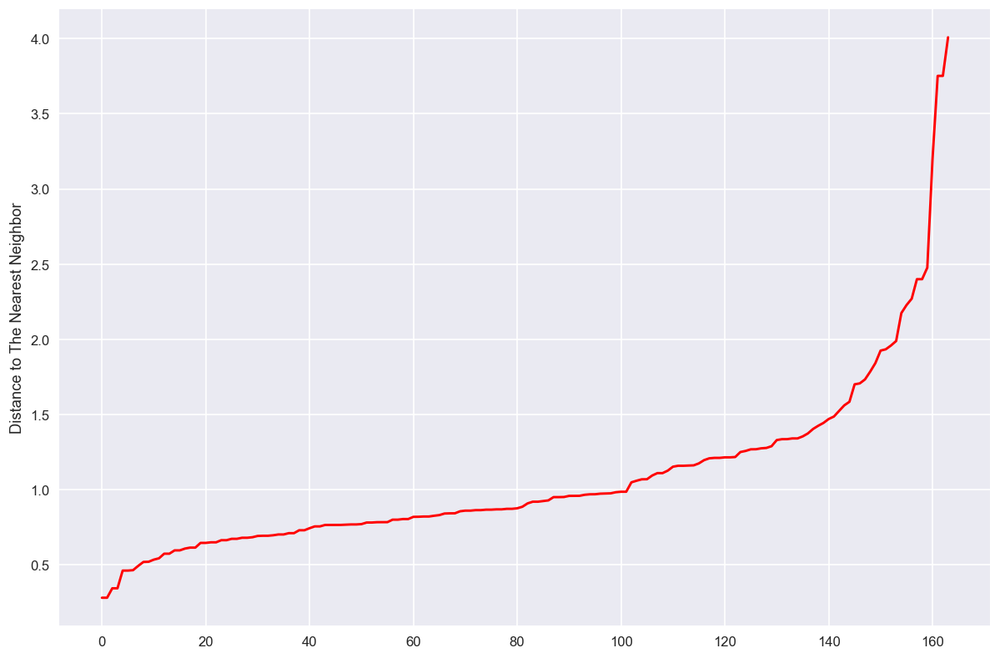

In [63]:
distances, *other = neighbors.kneighbors(X)
distances = distances[:, 1]
distances = np.sort(distances, axis = 0)

plt.style.use('seaborn')
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(distances, color = 'red')
plt.ylabel('Distance to The Nearest Neighbor')
plt.show()

--- Based on the plot above, the optimum value for *eps* is between 1.5 and 2.5 as the maximum curvature happened in this area.

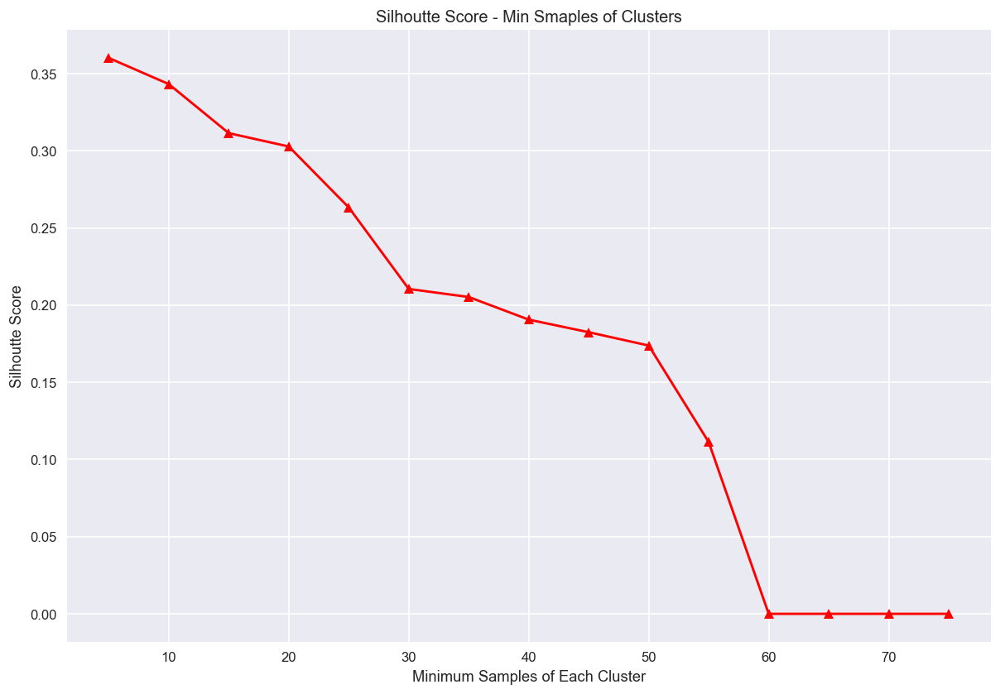

In [64]:
silhoutte_scores = []

for min_points in range(5, 80, 5):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    model = DBSCAN(eps = 2.0, min_samples = min_points)
    model.fit(X)
    try:
        silhoutte_scores.append(metrics.silhouette_score(X, model.labels_))
    except:
        silhoutte_scores.append(0)

plt.style.use('seaborn')
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(range(5, 80, 5), silhoutte_scores, color = 'r', marker = '^')
plt.xlabel('Minimum Samples of Each Cluster')
plt.ylabel('Silhoutte Score')
plt.title('Silhoutte Score - Min Smaples of Clusters')
plt.show()

--- As the *Silhouette score* decreased with each increase in the *min_samples*, the model probably has just one cluster for most of the samples, and the rest are classified as noise !

In [65]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = DBSCAN(eps = 2.0, min_samples = 5)
model.fit(X)

DBSCAN(eps=2.0)

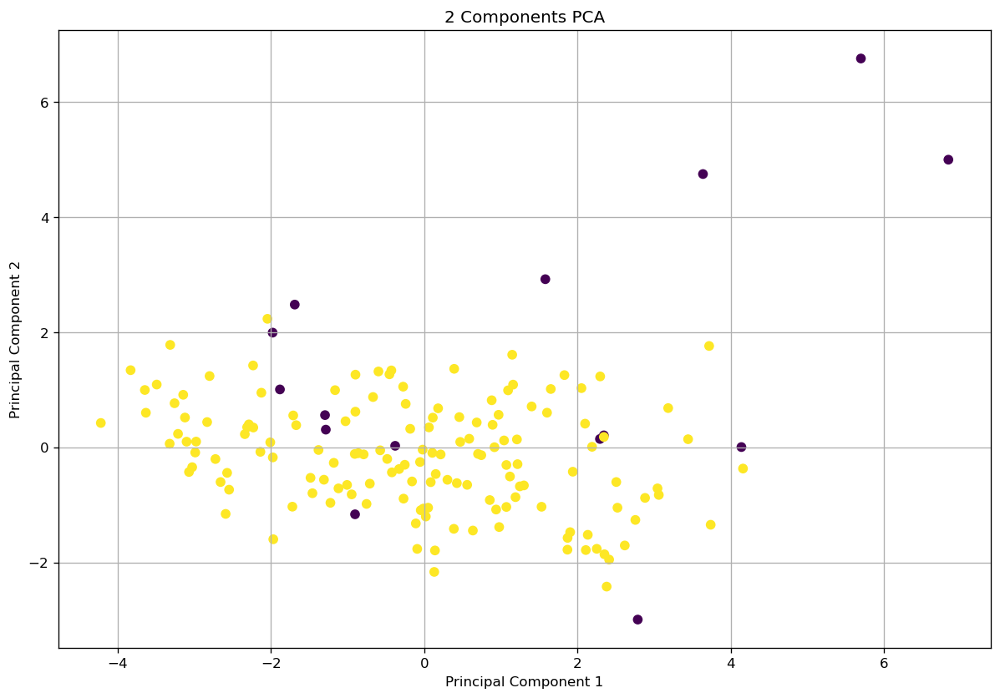

In [66]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

--- It can be seen that the theory of just one cluster and some noise is true. Again, considering that we want to find countries which are in need of financial aid, this algorithm does not do any good for the target!

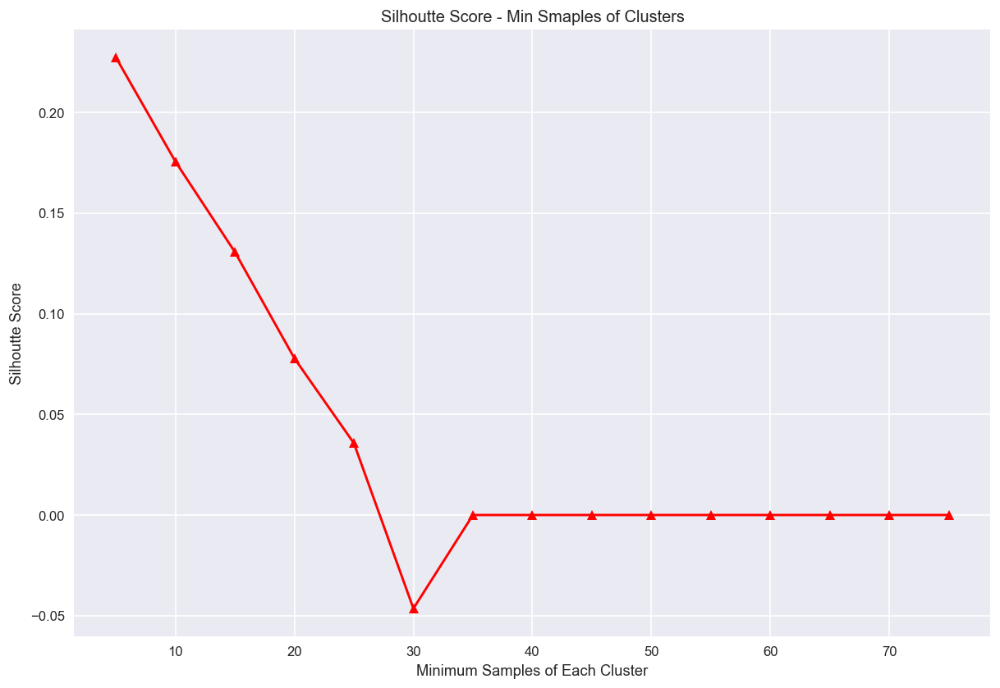

In [67]:
silhoutte_scores = []

for min_points in range(5, 80, 5):
    scaler = StandardScaler()
    X = scaler.fit_transform(df_1[features])
    model = DBSCAN(eps = 1.5, min_samples = min_points)
    model.fit(X)
    try:
        silhoutte_scores.append(metrics.silhouette_score(X, model.labels_))
    except:
        silhoutte_scores.append(0)

plt.style.use('seaborn')
plt.figure(figsize = (12, 8), dpi = 120)
plt.plot(range(5, 80, 5), silhoutte_scores, color = 'r', marker = '^')
plt.xlabel('Minimum Samples of Each Cluster')
plt.ylabel('Silhoutte Score')
plt.title('Silhoutte Score - Min Smaples of Clusters')
plt.show()

--- Even reducing the *eps* does not have any effect on the number of clusters!

In [68]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = DBSCAN(eps = 1.5, min_samples = 5)
model.fit(X)

DBSCAN(eps=1.5)

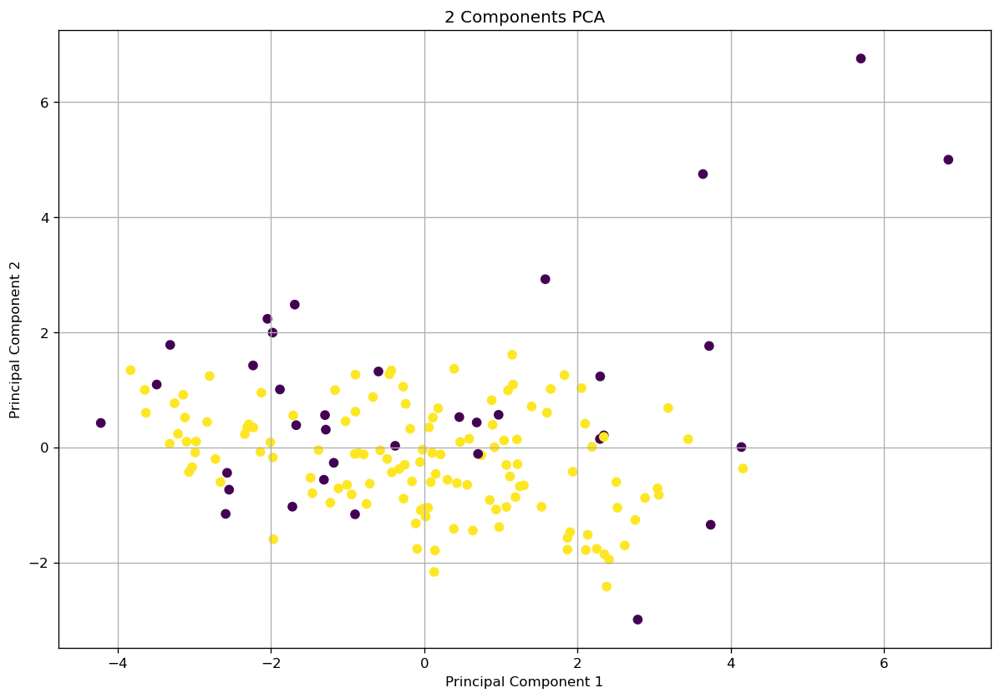

In [69]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [70]:
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Silhouette Score :  0.22724858420311075
CH Score :  8.576846693965663
DB Score :  3.7818522617248407


In [71]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.2555629174493449
CH Score :  10.347202942377521
DB Score :  3.068838873500394


--- Based on the results above, both visualization and evaluation parts, it can be concluded that density-based algorithms are not appropriate for this dataset, as the difference between clusters is not much about their density.

#### **BIRCH**

In [72]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = Birch()
model.fit(X)

Birch()

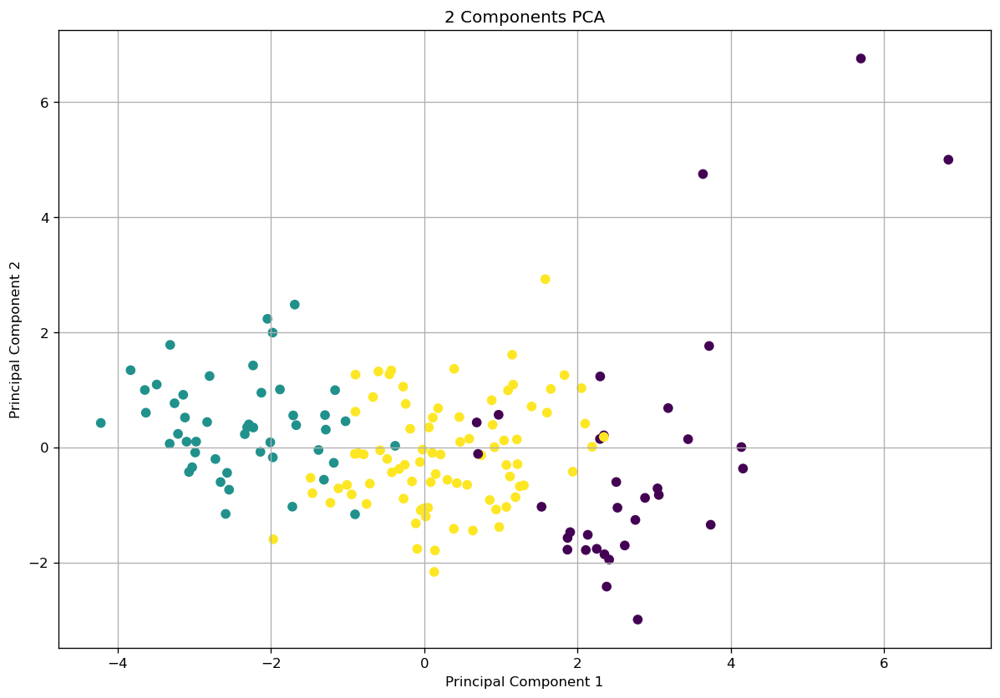

In [73]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [74]:
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Silhouette Score :  0.27637134268580904
CH Score :  62.52475422307317
DB Score :  1.349772245554113


In [75]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.2198393614029446
CH Score :  177.1538166138512
DB Score :  1.0220479775035873


--- It seems that the model worth being optimized as the classes are quite well separated in the plot above. Additionally, scores are not too bad considering that generally these metrics are slightly better for centroid-based algorithms, and *Birch* is not a centroid-based algorithm.

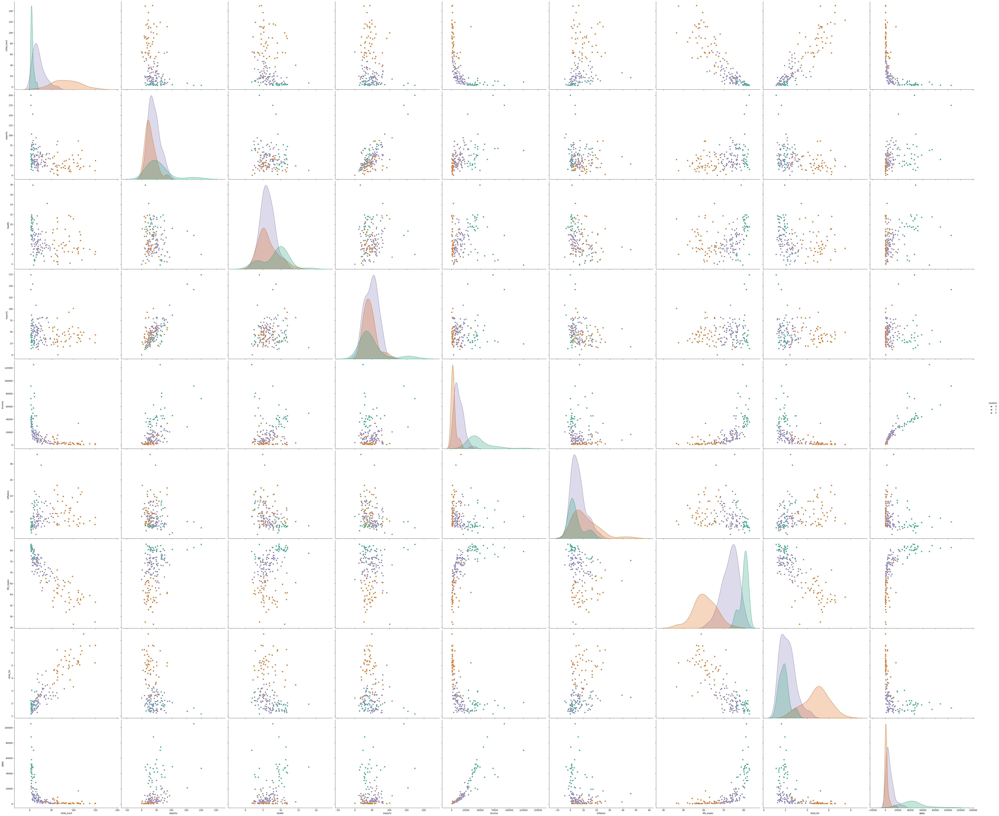

In [76]:
df_1['clusters'] = model.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')

--- Scatter plots above show reasonable amount of separability.

--- As we know from the *KMeans* and *Agglomerative Clustering*, number of clusters must be something between 2 to 4. Also, we know that the models might fit better on the non-normalized data. As a result, all combinations will be checked and compared with the model above, that has 3 clusters and fitted on the normalized data.

In [77]:
del df_1['clusters']

##### *2 clusters - Normalized Data*

In [78]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = Birch(n_clusters = 2)
model.fit(X)

Birch(n_clusters=2)

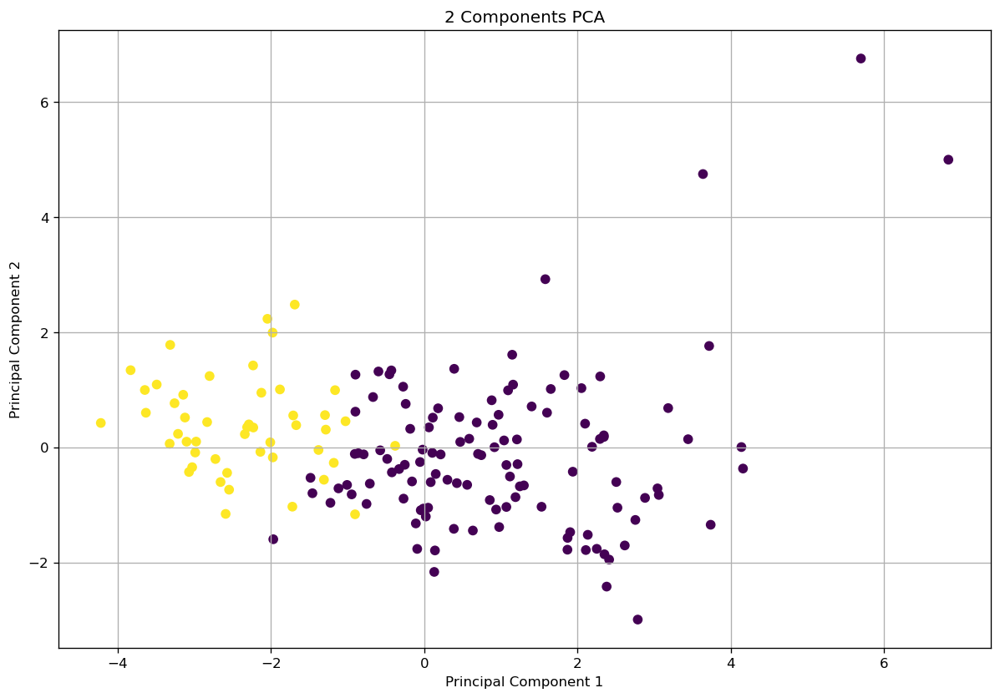

In [79]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [80]:
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Silhouette Score :  0.3061846657076791
CH Score :  65.84945625843775
DB Score :  1.249722491816813


In [81]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.044550047743952846
CH Score :  33.187118472471134
DB Score :  1.1048620192913021


--- This model is not acceptable based in the evaluation results on the raw data.

##### *4 clusters - Normalized Data*

In [82]:
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
model = Birch(n_clusters = 4)
model.fit(X)

Birch(n_clusters=4)

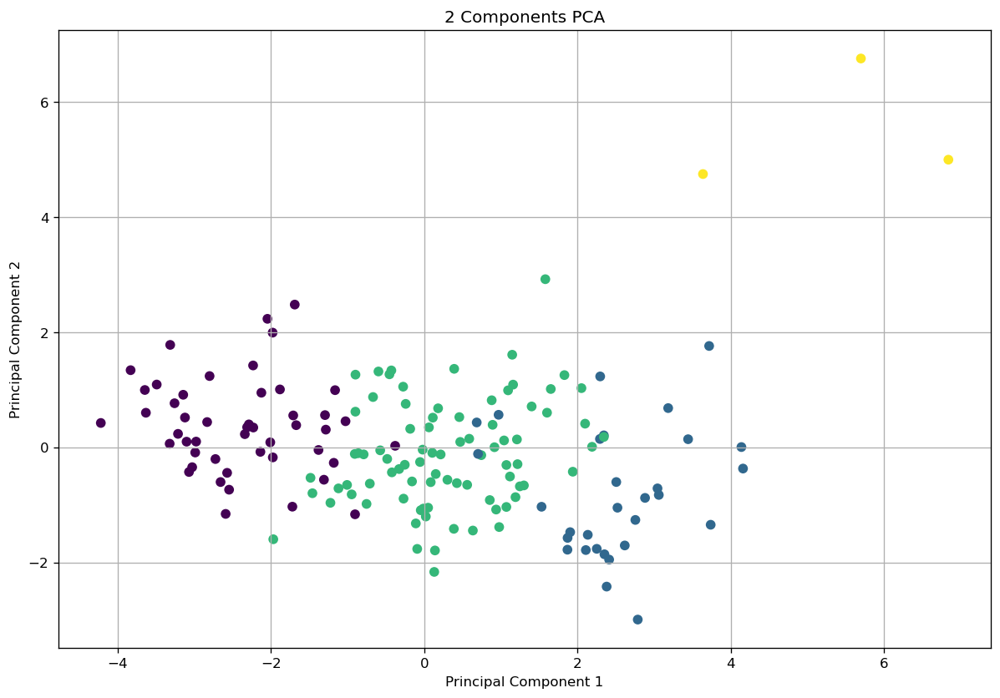

In [83]:
pca = PCA(2)
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [84]:
print('Silhouette Score : ', metrics.silhouette_score(X, model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, model.labels_))

Silhouette Score :  0.2864423516632515
CH Score :  59.45671018048232
DB Score :  1.1089477163529928


In [85]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.19906916398915805
CH Score :  124.67375021839139
DB Score :  1.8766649420441412


--- The notable thing about this model is that the outliers are in a seperate cluster. However, because of the evaluation results, it is not superior than the model with 3 clusters.

##### *2 clusters - non-Normalized Data*

In [86]:
X = df_1[features]
model = Birch(n_clusters = 2)
model.fit(X)

Birch(n_clusters=2)

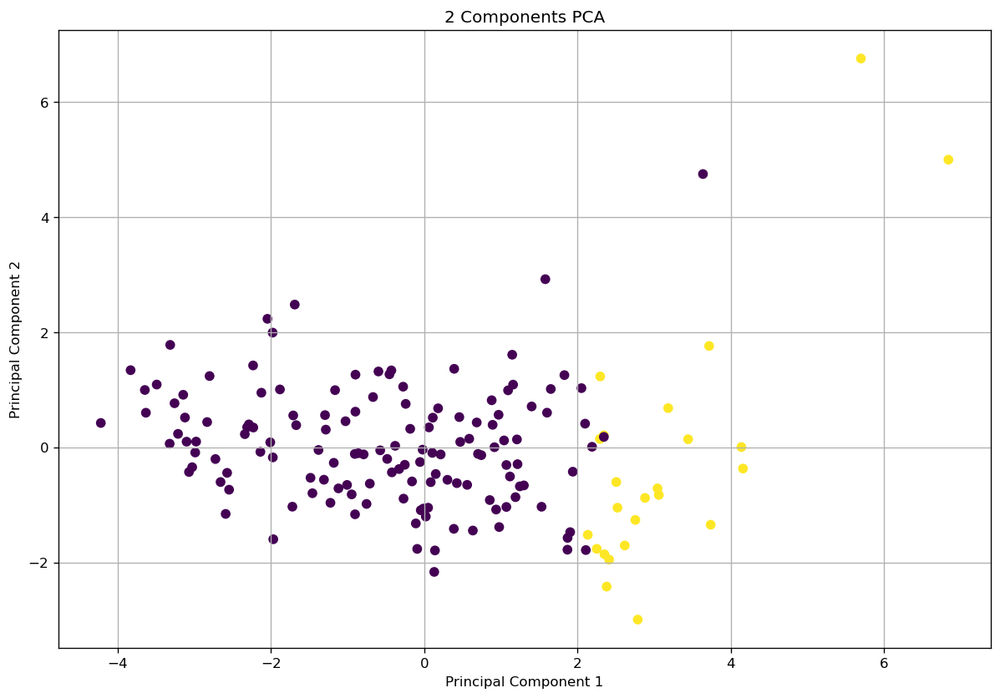

In [87]:
pca = PCA(2)
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [88]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.720047416807443
CH Score :  316.04121313804416
DB Score :  0.5140994252365614


--- It seems that this algorithm, just like *Agglomerative Clustering*, performs better with the non-normalized version of this dataset.

--- All scores are much better than previous models.

--- It is notable that the model is quite the same as the model using *Agglomerative Clustering* algorithm, fitted on the non-normalized data, and with 2 clusters.

##### *3 clusters - non-Normalized Data*

In [89]:
X = df_1[features]
model = Birch(n_clusters = 3)
model.fit(X)

Birch()

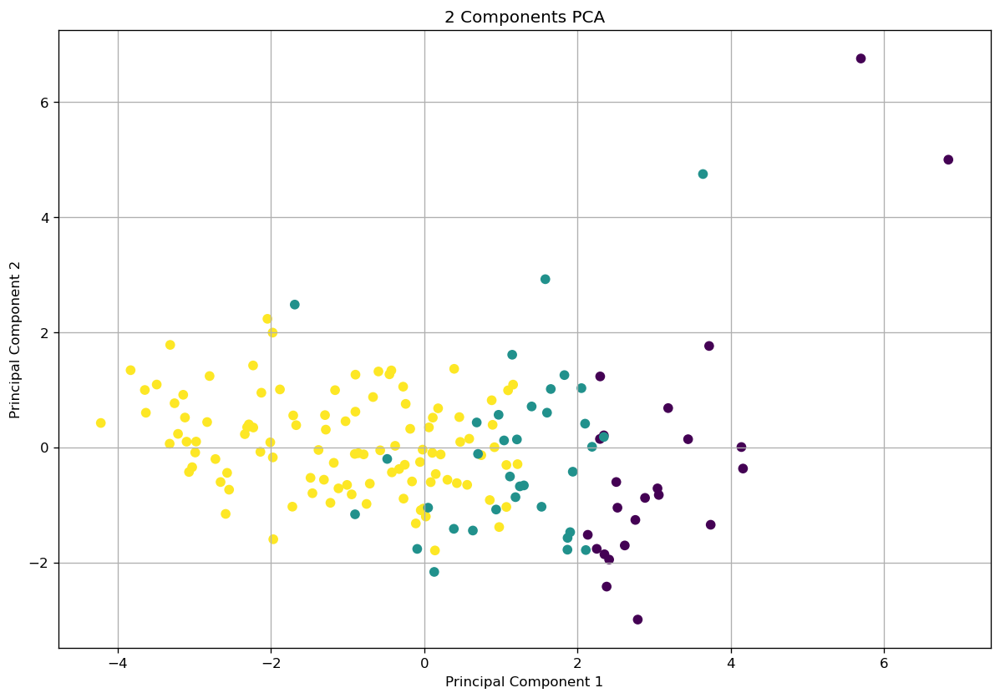

In [90]:
pca = PCA(2)
scaler = StandardScaler()
X = scaler.fit_transform(df_1[features])
principal_components = pca.fit_transform(X)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')
plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = model.labels_)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2 Components PCA')
plt.grid()
plt.show()

In [91]:
print('Silhouette Score : ', metrics.silhouette_score(df_1[features], model.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(df_1[features], model.labels_))
print('DB Score : ', metrics.davies_bouldin_score(df_1[features], model.labels_))

Silhouette Score :  0.5917349401217474
CH Score :  301.1297151822335
DB Score :  0.6720330855718967


--- Comparing these results with the one from *Agglomerative Clustering* algorithm, it seems that *Birch* has exactly the same performance with the non-normalized data!

In [ ]:
df_1['clusters'] = model.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')

--- Comparing the plots above with the model fitted on normalized data with exactly the same number of clusters, it could be concluded that despite the better evaluation results of the model using non-normalized data, separations are not as good as its counterpart.

#### **Selecting The Final Model**

--- Now from all models that has been trained, a handful of them are nominated to be our final model. For being able to perform a better comparison between these models, all of them are being trained and evaluated again.

--- KMeans : n_clusters = 4 - Normalized data

--- Affinity Propagation : damping = 0.9 - Normalized data

--- Agglomerative Clustering : n_clusters = 2, affinity = 'euclidean', linkage = 'ward' - non-Normalized data

--- Birch : n_clusters = 3 - Normalized data

In [93]:
kmeans = KMeans(n_clusters = 4, n_init = 100, random_state = 1)
affinity = AffinityPropagation(damping = 0.9, random_state = 1)
agg = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
birch = Birch(n_clusters = 3)

In [94]:
scaler = StandardScaler()
X_norm = scaler.fit_transform(df_1[features])
X = df_1[features]

In [95]:
kmeans.fit(X_norm)
affinity.fit(X_norm)
agg.fit(X)
birch.fit(X_norm)

Birch()

In [96]:
print('EVALUATION USING NORMALIZED DATA\n')
print('KMeans')
print('Silhouette Score : ', metrics.silhouette_score(X_norm, kmeans.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X_norm, kmeans.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X_norm, kmeans.labels_))
print('\nAffinity Propagation')
print('Silhouette Score : ', metrics.silhouette_score(X_norm, affinity.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X_norm, affinity.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X_norm, affinity.labels_))
print('\nAgglomerative Propagation')
print('Silhouette Score : ', metrics.silhouette_score(X_norm, agg.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X_norm, agg.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X_norm, agg.labels_))
print('\nBirch')
print('Silhouette Score : ', metrics.silhouette_score(X_norm, birch.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X_norm, birch.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X_norm, birch.labels_))

EVALUATION USING NORMALIZED DATA

KMeans
Silhouette Score :  0.29188878378474836
CH Score :  63.59825500452129
DB Score :  1.065355462154734

Affinity Propagation
Silhouette Score :  0.2999154070518763
CH Score :  33.732680104619924
DB Score :  0.8897111822774549

Agglomerative Propagation
Silhouette Score :  0.3367539318606151
CH Score :  46.8962622356457
DB Score :  1.2283472882605206

Birch
Silhouette Score :  0.27637134268580904
CH Score :  62.52475422307317
DB Score :  1.349772245554113


--- *Silhouette score* : agg - kmeans/affinity - birch

--- *Calinski-Harabsz* : kmeans/birch - agg - affinity

--- *Davies-Bouldin* : aff - kmeans - agg - birch

--- Comparing the scores above, it seems that *Birch* is the worst among them all.

In [97]:
print('EVALUATION USING non-NORMALIZED DATA\n')
print('KMeans')
print('Silhouette Score : ', metrics.silhouette_score(X, kmeans.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, kmeans.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, kmeans.labels_))
print('\nAffinity Propagation')
print('Silhouette Score : ', metrics.silhouette_score(X, affinity.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, affinity.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, affinity.labels_))
print('\nAgglomerative Propagation')
print('Silhouette Score : ', metrics.silhouette_score(X, agg.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, agg.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, agg.labels_))
print('\nBirch')
print('Silhouette Score : ', metrics.silhouette_score(X, birch.labels_))
print('CH Score : ', metrics.calinski_harabasz_score(X, birch.labels_))
print('DB Score : ', metrics.davies_bouldin_score(X, birch.labels_))

EVALUATION USING non-NORMALIZED DATA

KMeans
Silhouette Score :  0.2026204692139129
CH Score :  122.51580459902506
DB Score :  1.7400448047601627

Affinity Propagation
Silhouette Score :  0.6487600125176919
CH Score :  100.0897795552249
DB Score :  2.4195484248070103

Agglomerative Propagation
Silhouette Score :  0.720047416807443
CH Score :  316.04121313804416
DB Score :  0.5140994252365614

Birch
Silhouette Score :  0.2198393614029446
CH Score :  177.1538166138512
DB Score :  1.0220479775035873


--- *Silhouette score* : agg - affinity - birch - kmeans

--- *Calinski-Harabsz* : agg - birch - kmeans - affinity

--- *Davies-Bouldin* : agg - birch - kmeans - affinity

--- Comparing the metrics using non-normalized data, it can be seen that *Agglomerative Clustering* outperformed all other algorithms. The only downside of this algorithm is that because of the nature of our problem, 2 clusters might not be the most suitable number of clusters!

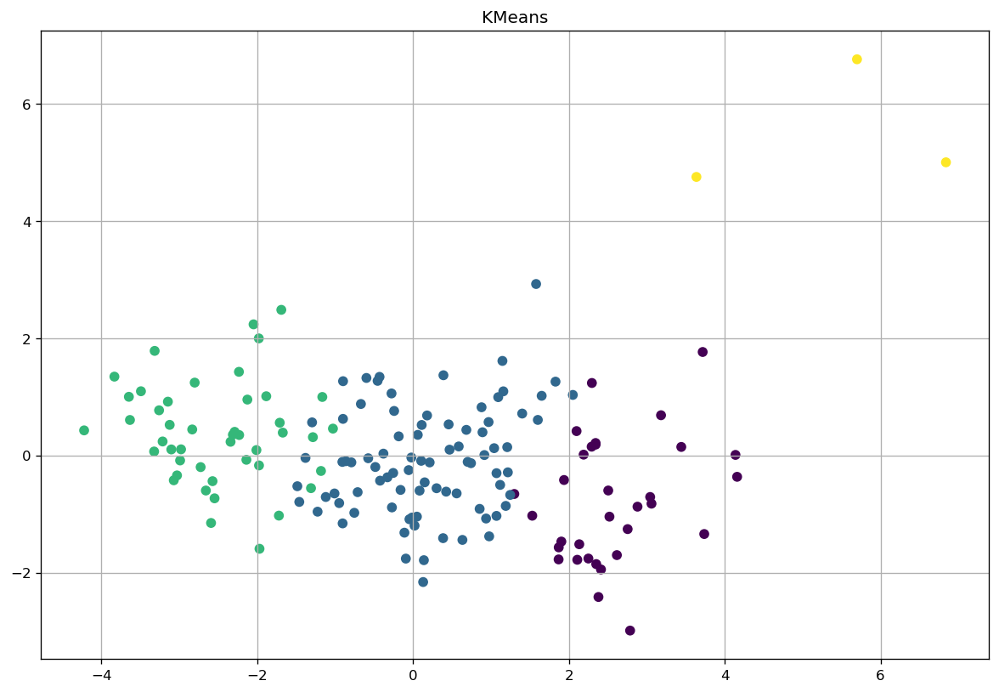

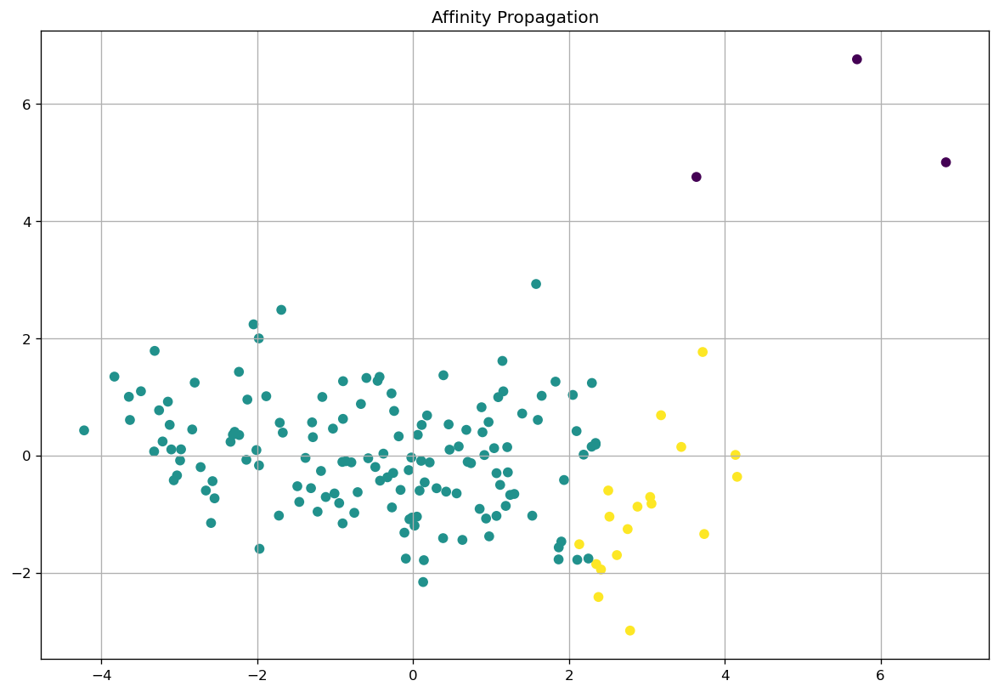

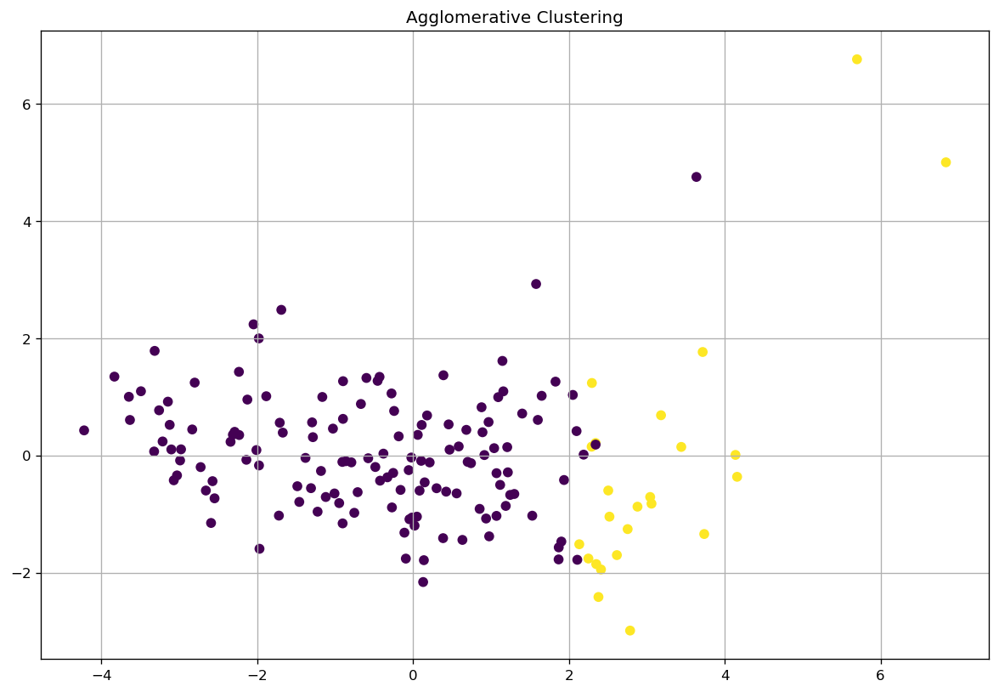

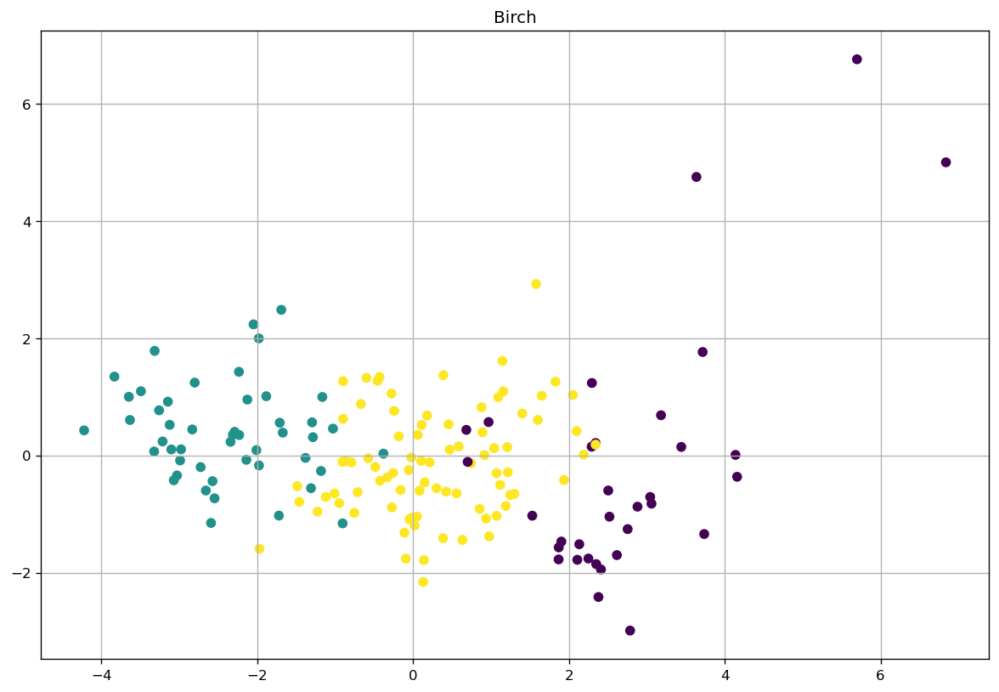

In [98]:
pca = PCA(2)
principal_components = pca.fit_transform(X_norm)
df_pca = pd.DataFrame(principal_components, columns = ['pca_1', 'pca_2'])

plt.style.use('default')

fig = plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = kmeans.labels_)
plt.title('KMeans')
plt.grid()

fig = plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = affinity.labels_)
plt.title('Affinity Propagation')
plt.grid()

fig = plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = agg.labels_)
plt.title('Agglomerative Clustering')
plt.grid()

fig = plt.figure(figsize = (12, 8), dpi = 120)
plt.scatter(df_pca['pca_1'], df_pca['pca_2'], c = birch.labels_)
plt.title('Birch')
plt.grid()

--- Observing the plots above, I personally prefer to go with either *KMeans* or *Birch*. The reasons why I don't like the two other is that *Agglomerative Clustering* divided the samples into 2 clusters and it is not what we need for this dataset. In addition, *Affinity Propagation* has one big cluster against 2 relatively small clusters which might not represent the data well enough.

KMeans


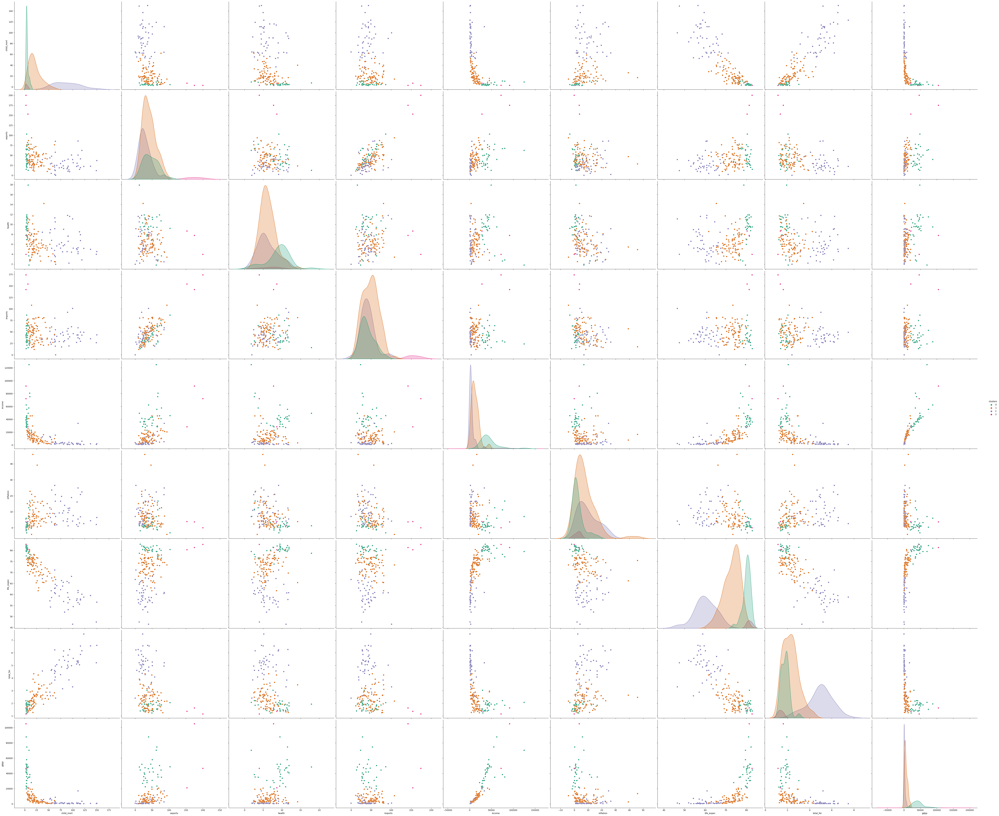

In [99]:
print('KMeans')
df_1['clusters'] = kmeans.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')
plt.show()


Affinity Propagation


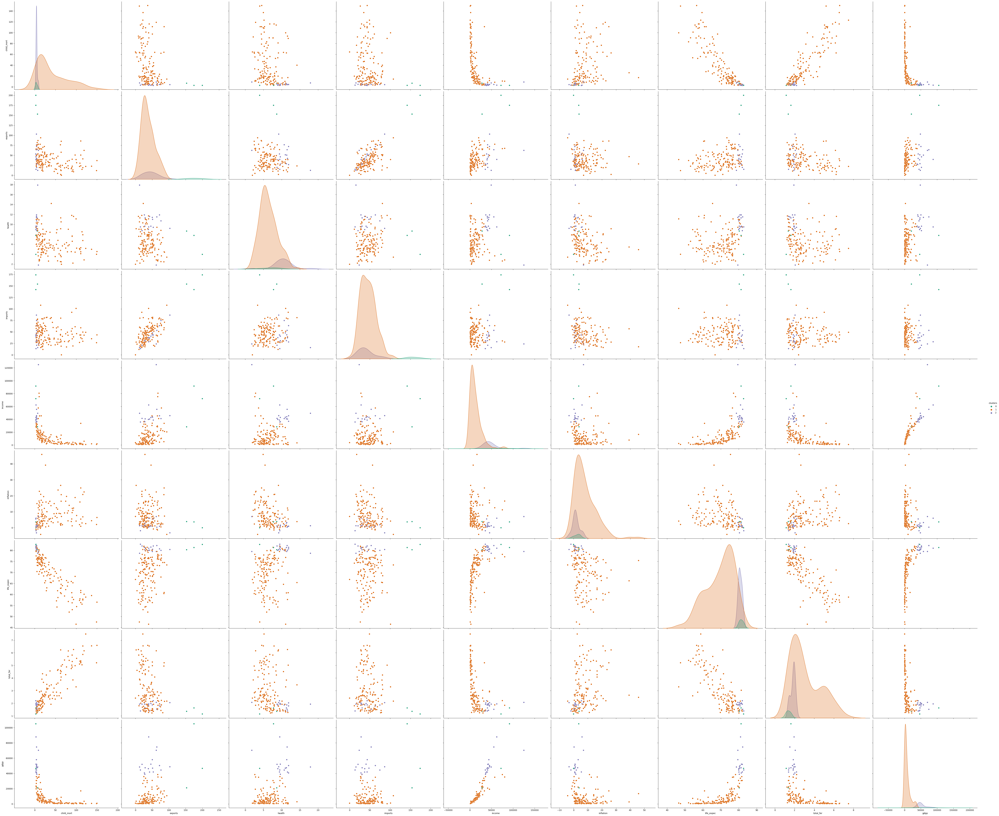

In [100]:
print('\nAffinity Propagation')
df_1['clusters'] = affinity.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')
plt.show()


Agglomerative Clustering


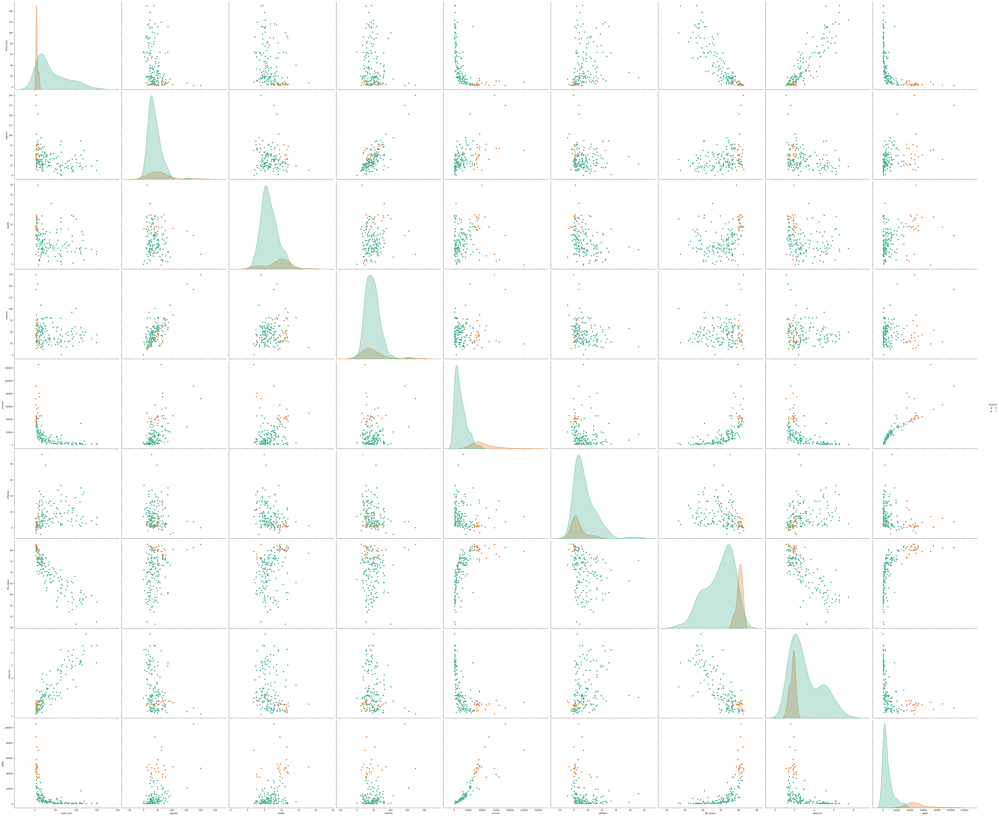

In [101]:
print('\nAgglomerative Clustering')
df_1['clusters'] = agg.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')
plt.show()


Birch


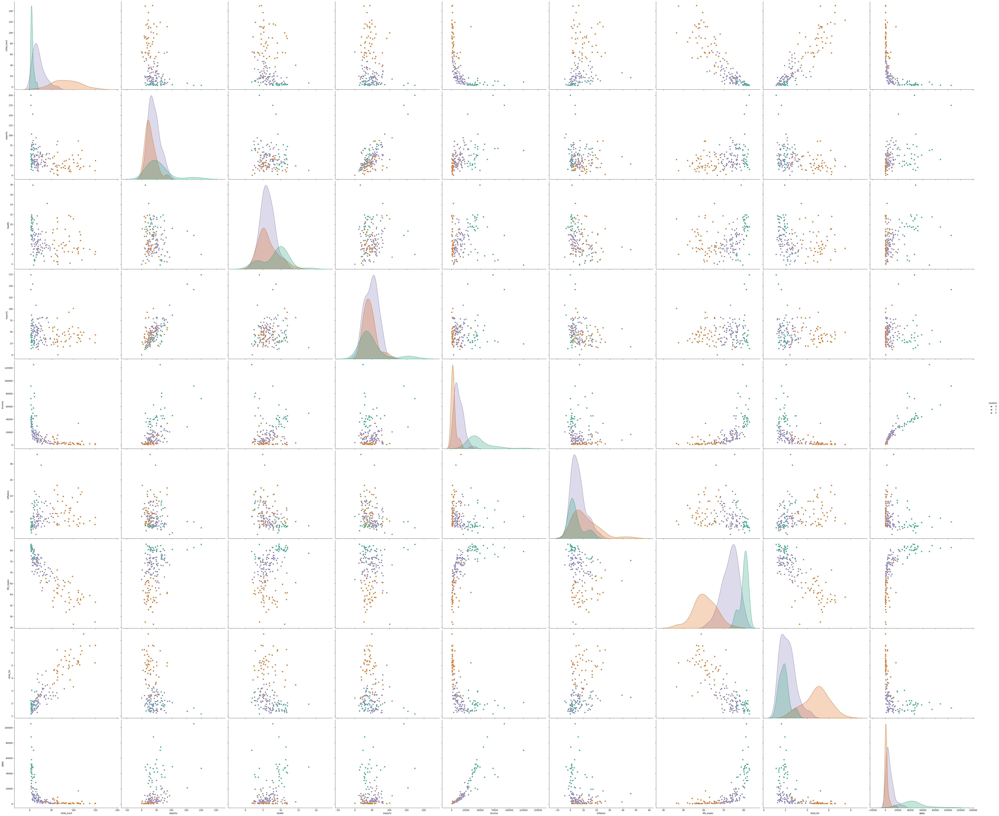

In [102]:
print('\nBirch')
df_1['clusters'] = birch.labels_
sns.pairplot(df_1, palette='Dark2', height = 6, aspect = 1.2, kind = 'scatter', diag_kind = 'kde', hue = 'clusters')
plt.show()

--- After comparing the pairplots of all four models, I prefer to stick with either *Birch* or *Kmeans* for the afformentioned reasons. For choosing the most suitable model for our problem between these two, it should be checked that each model, along which features performed better, to compare it with human Logic.

--- *KMeans* : child_mort, life_expec, gpdd

--- *Birch* : child_mort, life_expec, income, gdpp

--- After the final comparison, I believe that *Birch* has shown a more logical performance. Not only it is more separable along the feature *income*, it also has less density overlap along most of the features as it can be seen in the kde plots. Moreover, Along *gdpp*, samples of different clusters are more separable in comparison with *KMeans*.

#### **Final Answer of The problem**

In [103]:
df_1['clusters'] = birch.labels_

In [104]:
df_1['clusters'].value_counts()

2    83
1    48
0    33
Name: clusters, dtype: int64

In [105]:
groups = df_1.groupby(['clusters'])
groups.get_group(0).agg(['mean', 'std', 'min', 'max'])

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp,clusters
min,Australia,2.600000,12.400000,1.810000,13.600000,27200.000000,-3.220000,75.100000,1.150000,12100.000000,0.0
max,United States,16.600000,200.000000,17.900000,174.000000,125000.000000,17.200000,82.800000,3.030000,105000.000000,0.0
mean,NaN,5.881818,58.175758,8.608182,48.842424,47784.848485,4.014758,80.103030,1.880303,43851.515152,0.0
std,NaN,3.581415,43.673963,3.561049,38.242393,20862.483092,5.520294,1.994443,0.460750,19352.246659,0.0


In [106]:
groups.get_group(1).agg(['mean', 'std', 'min', 'max'])

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp,clusters
min,Afghanistan,17.100000,2.200000,2.200000,17.200000,609.000000,0.885000,46.500000,2.470000,231.000000,1.0
max,Zambia,150.000000,85.800000,14.200000,101.000000,33700.000000,45.900000,75.400000,7.490000,17100.000000,1.0
mean,NaN,83.475000,29.714792,6.368958,43.468750,4314.229167,11.243229,60.641667,4.856042,2223.104167,1.0
std,NaN,30.069314,18.066111,2.702127,18.333427,5867.885955,9.742242,5.676410,1.147819,3359.361776,0.0


In [107]:
groups.get_group(2).agg(['mean', 'std', 'min', 'max'])

,country,child_mort,exports,health,imports,income,inflation,life_expec,total_fer,gdpp,clusters
min,Albania,3.200000,0.109000,1.970000,0.065900,1780.000000,-4.210000,61.700000,1.230000,592.000000,2.0
max,Vietnam,64.400000,93.800000,11.700000,108.000000,41100.000000,22.800000,80.400000,4.340000,30800.000000,2.0
mean,NaN,20.387952,41.707096,6.305542,48.382722,12907.349398,6.033181,73.265060,2.202410,7323.060241,2.0
std,NaN,13.878404,19.436467,1.987050,19.903300,7910.682510,5.481172,4.027268,0.695125,6214.954948,0.0


--- As it can be precieved from the tables above, countries of cluster 1 are more in need of financial support. They have much smaller economy in comarison with the two other groups. In addition, the rate of inflation is higher among countries of cluster 1. In contrast, total fertility is also higher, that is to say, they have less money while they have to support more people! Another noticable gap, is the average salaries of these countries. However, it seems that some of the samples are misclassified, as it can be concluded by comparing the min and max of features of each group. 

In [108]:
len(groups.get_group(1))

48

In [109]:
groups.get_group(1)['country']

0                   Afghanistan
3                        Angola
17                        Benin
21                     Botswana
25                 Burkina Faso
26                      Burundi
28                     Cameroon
31     Central African Republic
32                         Chad
36                      Comoros
37             Congo, Dem. Rep.
38                  Congo, Rep.
40                Cote d'Ivoire
49            Equatorial Guinea
50                      Eritrea
55                        Gabon
56                       Gambia
59                        Ghana
63                       Guinea
64                Guinea-Bissau
71                         Iraq
79                        Kenya
80                     Kiribati
83                          Lao
86                      Lesotho
87                      Liberia
92                   Madagascar
93                       Malawi
96                         Mali
98                   Mauritania
100       Micronesia, Fed. Sts.
102     

--- Counrtis above, are the ones nominated to recieve financial aid. However, it should be noted that as there is no perfect model, some countries of other groups, especially cluster 2, might be more deserved for support as there are some misclassifications.